In [1]:
import scanpy as sc
import scarches
from scarches.models.scpoli import scPoli
import scib
import os
import anndata
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
 captum (see https://github.com/pytorch/captum).


# Prepare reference

In [7]:
adata = sc.read_h5ad("mse3-reload-hvg-level1_corrected2-preint.h5ad") # before integration so correct normalization etc. counts is rounded_corrected_counts, still has the unknowns

In [8]:
adata

AnnData object with n_obs × n_vars = 184635 × 2000
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'cell_type_level1_corrected', 'atlas_key'
    var: 'original_gene_names', 'highly_variable'
    uns: 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'raw_decontXcounts', 'uncorrected_counts'
    obsp: 'connectivities', 'distances'

In [10]:
adata.obs["cell_type_level1_corrected"].value_counts()

cell_type_level1_corrected
T cell                99886
Macrophage            16870
unknown               11863
Smooth Muscle Cell     9405
B cell                 8610
Monocyte               8094
NK cell                7177
EC                     6610
Fibroblast             4976
Neutrophil             2985
Dendritic cell         2679
Fibromyocyte           2419
Mast cell              1531
Plasma cell            1530
Name: count, dtype: int64

In [11]:
# transfer new annotation and remove cells that i removed so we have the correct reference

In [12]:
adata_new = sc.read_h5ad("Altas_level1-noprototypes-allgenes-names-mse3-reload-corrected2-nouncert.h5ad") # new pipeline with pdcs and no uncertains

In [13]:
adata_new

AnnData object with n_obs × n_vars = 184094 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1'
    var: 'original_gene_names', 'ensembl_id'
    uns: 'log1p'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [15]:
#Subset adata to include only the cells in adata_new
adata = adata[adata_new.obs_names].copy()

# Transfer the "cell_type_level1" column from adata_new to adata
adata.obs['cell_type_level1'] = adata_new.obs['cell_type_level1'].reindex(adata.obs_names).values

In [16]:
adata.obs['cell_type_level1'].value_counts()

cell_type_level1
T cell                102066
Macrophage             19225
NK cell                10613
Smooth Muscle Cell      9525
Monocyte                9084
B cell                  8691
EC                      6611
Fibroblast              5242
Dendritic cell          4139
Neutrophil              3016
Fibromyocyte            2617
Mast cell               1707
Plasma cell             1558
Name: count, dtype: int64

In [17]:
del adata.obs["atlas_key"]
del adata.obs["cell_type_level1_corrected"]

In [17]:
adata.write("atlas_reference_hvg_nobashore_log1p.h5ad")

# Train reference

In [18]:
early_stopping_kwargs = {
    "early_stopping_metric": "val_prototype_loss",
    "mode": "min",
    "threshold": 0,
    "patience": 20,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}
    
scpoli_model = scPoli(
adata=adata,
condition_keys="sample",
cell_type_keys="cell_type_level1", 
embedding_dims=10,
recon_loss='mse',
)

scpoli_model.train(
    n_epochs=50,
    pretraining_epochs=40,
    early_stopping_kwargs=early_stopping_kwargs,
    eta=5,
)


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:151: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_metadata_ = adata.obs.groupby('conditions_combined').first()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:156: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_metadata_ = adata.obs.groupby(condition_keys).first()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/sc

Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



'\nscpoli_model.train(\n    n_epochs=50,\n    pretraining_epochs=40,\n    early_stopping_kwargs=early_stopping_kwargs,\n    eta=5,\n)\n'

In [18]:
scpoli_model.save("models/reference_mapping_level1_corrected2", overwrite=True) # new pipeline with pdcs

# Prepare Bashore query data

In [2]:
adata_bashore = sc.read_h5ad("bashore-aggr-QC-log-normalized.h5ad")

In [3]:
adata_bashore.X.sum()

161061784.6278424

In [8]:
adata_bashore

AnnData object with n_obs × n_vars = 77112 × 28599
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'
    uns: 'log1p'

In [4]:
adata_bashore.obs['cell_type_level1'] = "unknown"

In [5]:
from scarches.models.base._utils import _validate_var_names

In [6]:
varnames_path = "models/reference_mapping_level1_corrected2/var_names.csv"
var_names = np.genfromtxt(varnames_path, delimiter=",", dtype=str)
adata_query = _validate_var_names(adata_bashore, var_names)

Query data is missing expression data of  9  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


Query data contains expression data of  26608  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 77112 × 2000
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1'


In [23]:
adata_query.write("atlas_query_hvg_bashore_log1p.h5ad")

# Train query

In [24]:
scpoli_query = scPoli.load_query_data(
    adata=adata_query,
    reference_model=scpoli_model,
    labeled_indices=[],
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:777: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  new_obs_metadata = adata.obs.groupby('conditions_combined').first()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:156: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_metadata_ = adata.obs.groupby(condition_keys).first()


Embedding dictionary:
 	Num conditions: [79]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [24]:
scpoli_query.train(
    n_epochs=50,
    pretraining_epochs=40,
    eta=10
)

The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
Initializing dataloaders
Starting training
 |████████████████----| 80.0%  - val_loss:  298.06 - val_cvae_loss:  298.06
Initializing unlabeled prototypes with Leiden with an unknown number of  clusters.
Clustering succesful. Found 37 clusters.
 |████████████████████| 100.0%  - val_loss:  301.31 - val_cvae_loss:  301.31 - val_prototype_loss:    0.00 - val_unlabeled_loss:    0.20


In [25]:
scpoli_query.save("models/bashore-mapping-corrected2", overwrite=True)

# Create embedding adata

In [25]:
scpoli_query = scpoli_query.load(dir_path="models/bashore-mapping-corrected2", adata=adata_query)

AnnData object with n_obs × n_vars = 77112 × 2000
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1', 'conditions_combined'
Embedding dictionary:
 	Num conditions: [79]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:156: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  self.obs_metadata_ = adata.obs.groupby(condition_keys).first()


In [26]:
adata_query.X = adata_query.X.astype("float32")

In [51]:
results_dict = scpoli_query.classify(adata_query, scale_uncertainties=True)

In [52]:
#get whole atlas including reference

#get latent representation of reference data
scpoli_query.model.eval()
data_latent_source = scpoli_query.get_latent(
    adata,
    mean=True
)

adata_latent_source = sc.AnnData(data_latent_source)
adata_latent_source.obs = adata.obs.copy()

#get latent representation of query data
data_latent= scpoli_query.get_latent(
    adata_query,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_query.obs.copy()

#get label annotations
adata_latent.obs['cell_type_pred'] = results_dict['cell_type_level1']['preds'].tolist()
adata_latent.obs['cell_type_uncert'] = results_dict['cell_type_level1']['uncert'].tolist()
#adata_latent.obs['classifier_outcome'] = (adata_latent.obs['cell_type_pred'] == adata_latent.obs['cell_type_level1'])

#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent],
    batch_key='query'
)


adata_latent_full.obs['cell_type_pred_ref'] = np.where(
    adata_latent_full.obs['query'].isin(['0']),  # Condition
    "Reference",                                # Value if condition is true
    adata_latent_full.obs['cell_type_pred']     # Value if condition is false
)

/tmp/ipykernel_2817318/660821678.py:28: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_latent_full = adata_latent_source.concatenate(


In [53]:
adata_latent_full.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,...,symptoms,n_genes,n_counts,size_factors,cell_type_level1,conditions_combined,cell_type_pred,cell_type_uncert,query,cell_type_pred_ref
car02_d_AAATGGATCGAGTGGA.1-0,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,...,NaN,NaN,NaN,0.306150,T cell,2_Roche,NaN,NaN,0,Reference
car02_d_AAGGAATGTCGTTGGC.1-0,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,...,NaN,NaN,NaN,2.219434,Macrophage,2_Roche,NaN,NaN,0,Reference
car02_d_AATGGCTTCTTCCAGC.1-0,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,...,NaN,NaN,NaN,9.472461,Macrophage,2_Roche,NaN,NaN,0,Reference
car02_d_ACCTACCGTTTACTGG.1-0,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,...,NaN,NaN,NaN,0.099273,Plasma cell,2_Roche,NaN,NaN,0,Reference
car02_d_ACCTGAAGTCATCCCT.1-0,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,...,NaN,NaN,NaN,0.092680,Mast cell,2_Roche,NaN,NaN,0,Reference
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTGTTAGGCTT-1_12-1,Bashore,NaN,3987.0,15946.0,485.0,3.041515,12_Bashore,NaN,NaN,NaN,...,NaN,3987.0,15945.0,2.364527,unknown,12_Bashore,Fibromyocyte,0.034522,1,Fibromyocyte
TTTGTTGCAACTGCCG-1_12-1,Bashore,NaN,5827.0,27851.0,791.0,2.840113,12_Bashore,NaN,NaN,NaN,...,NaN,5827.0,27851.0,5.816382,unknown,12_Bashore,EC,0.063910,1,EC
TTTGTTGGTAGTCTGT-1_12-1,Bashore,NaN,3065.0,10611.0,578.0,5.447177,12_Bashore,NaN,NaN,NaN,...,NaN,3065.0,10611.0,1.486614,unknown,12_Bashore,Smooth Muscle Cell,0.033648,1,Smooth Muscle Cell
TTTGTTGGTTACCGTA-1_12-1,Bashore,NaN,2825.0,7735.0,629.0,8.131868,12_Bashore,NaN,NaN,NaN,...,NaN,2825.0,7735.0,1.390295,unknown,12_Bashore,Fibromyocyte,0.048397,1,Fibromyocyte


In [56]:
adata_latent_full

AnnData object with n_obs × n_vars = 261206 × 10
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'query', 'cell_type_pred_ref'

In [57]:
# Create 'cell_type_level1_combined' based on the 'query' condition
adata_latent_full.obs['cell_type_level1_combined'] = np.where(
    adata_latent_full.obs['query'] == "0",
    adata_latent_full.obs['cell_type_level1'],
    adata_latent_full.obs['cell_type_pred_ref']
)

In [58]:
adata_latent_full.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,...,n_genes,n_counts,size_factors,cell_type_level1,conditions_combined,cell_type_pred,cell_type_uncert,query,cell_type_pred_ref,cell_type_level1_combined
car02_d_AAATGGATCGAGTGGA.1-0,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,...,NaN,NaN,0.306150,T cell,2_Roche,NaN,NaN,0,Reference,T cell
car02_d_AAGGAATGTCGTTGGC.1-0,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,...,NaN,NaN,2.219434,Macrophage,2_Roche,NaN,NaN,0,Reference,Macrophage
car02_d_AATGGCTTCTTCCAGC.1-0,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,...,NaN,NaN,9.472461,Macrophage,2_Roche,NaN,NaN,0,Reference,Macrophage
car02_d_ACCTACCGTTTACTGG.1-0,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,...,NaN,NaN,0.099273,Plasma cell,2_Roche,NaN,NaN,0,Reference,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1-0,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,...,NaN,NaN,0.092680,Mast cell,2_Roche,NaN,NaN,0,Reference,Mast cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTGTTAGGCTT-1_12-1,Bashore,NaN,3987.0,15946.0,485.0,3.041515,12_Bashore,NaN,NaN,NaN,...,3987.0,15945.0,2.364527,unknown,12_Bashore,Fibromyocyte,0.034522,1,Fibromyocyte,Fibromyocyte
TTTGTTGCAACTGCCG-1_12-1,Bashore,NaN,5827.0,27851.0,791.0,2.840113,12_Bashore,NaN,NaN,NaN,...,5827.0,27851.0,5.816382,unknown,12_Bashore,EC,0.063910,1,EC,EC
TTTGTTGGTAGTCTGT-1_12-1,Bashore,NaN,3065.0,10611.0,578.0,5.447177,12_Bashore,NaN,NaN,NaN,...,3065.0,10611.0,1.486614,unknown,12_Bashore,Smooth Muscle Cell,0.033648,1,Smooth Muscle Cell,Smooth Muscle Cell
TTTGTTGGTTACCGTA-1_12-1,Bashore,NaN,2825.0,7735.0,629.0,8.131868,12_Bashore,NaN,NaN,NaN,...,2825.0,7735.0,1.390295,unknown,12_Bashore,Fibromyocyte,0.048397,1,Fibromyocyte,Fibromyocyte


In [59]:
sc.pp.neighbors(adata_latent_full, n_neighbors=15)
sc.tl.umap(adata_latent_full)

In [61]:
color_palette_level1 = {
    'T cell': '#3182bd',                       # blue for all T cell types
    'Macrophage': '#8c564b',                   # brown for all macrophages
    'Plasma cell': '#ff7f0e',                  # vibrant orange
    'Mast cell': '#d62728',                    # red
    'NK cell': '#98df8a',                      # light green
    'Fibromyocyte': '#f7b6d2',                 # pastel pink
    'Smooth Muscle Cell': '#7b4173',           # deeper purple
    'Fibroblast': '#e377c2',                   # bright pink
    'B cell': '#2ca02c',                       # green
    'Dendritic cell': '#807dba',               # violet for dendritic cells
    'EC': '#fdae6b',                           # orange for all endothelial cells  
    'Monocyte': '#c7c7c7',                     # lighter gray
    'Neutrophil': '#17becf',                   # teal
    "Reference": "#ececec"                     # light gray
}

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


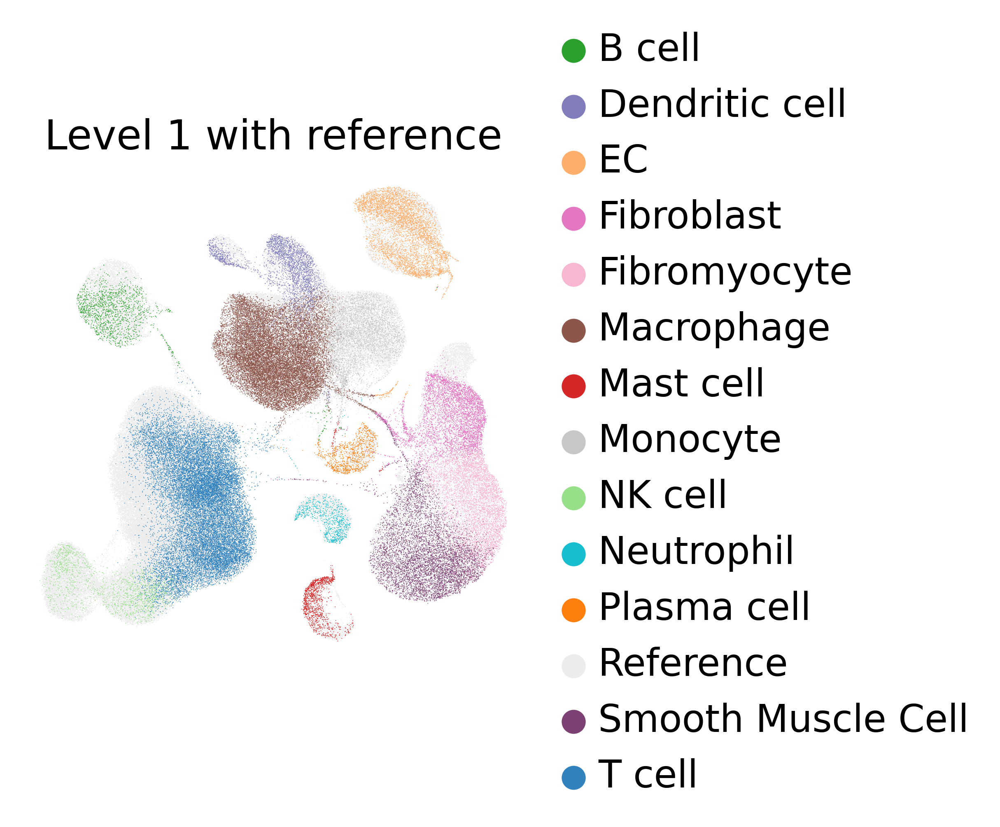

In [73]:
# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full,
    color='cell_type_pred_ref',
    palette=color_palette_level1,
    show=True,
    frameon=False,
    title = "Level 1 with reference",
    save="Big-Atlas-corrected2-level1-withReference.pdf"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


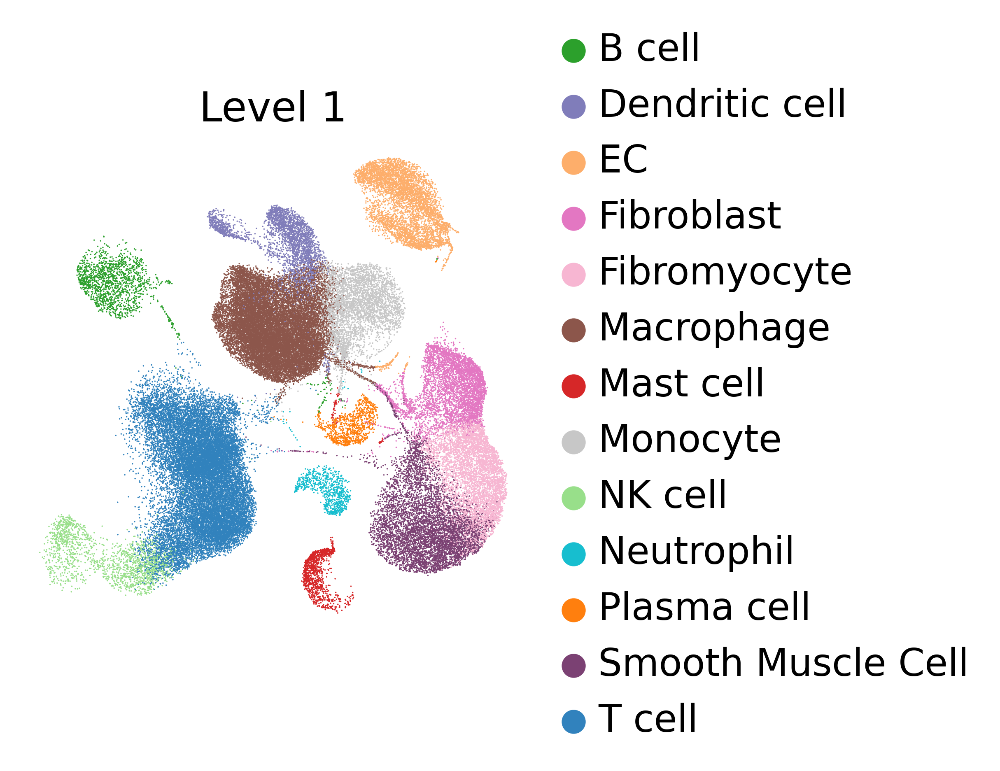

In [72]:
# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full[adata_latent_full.obs["cell_type_pred_ref"]!="Reference"],
    color='cell_type_pred_ref',
    palette=color_palette_level1,
    show=True,
    frameon=False,
    title = "Level 1",
    save="Big-Atlas-corrected2-level1-withoutReference.pdf"
)

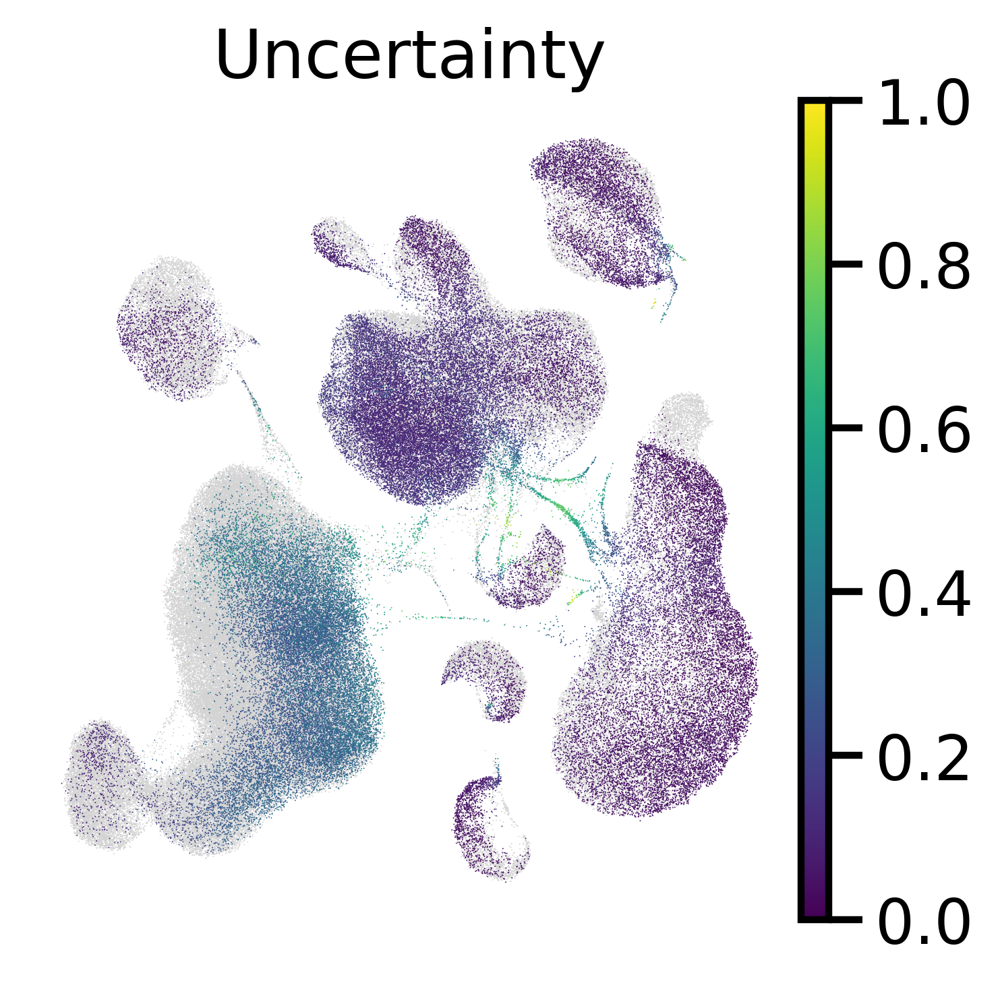

In [63]:
# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full,
    color='cell_type_uncert',
    #palette=color_palette_level2,
    show=True,
    frameon=False,
    title = "Uncertainty",
    save="Big-Atlas-corrected2-level1-uncertainty.pdf"
)

In [68]:
adata_latent_full

AnnData object with n_obs × n_vars = 261206 × 10
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'query', 'cell_type_pred_ref', 'cell_type_level1_combined'
    uns: 'neighbors', 'umap', 'cell_type_pred_ref_colors'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

In [67]:
adata_latent_full.write("Big-Atlas-withBashore-corrected2-embed-withuncert-PLOTS.h5ad") # recalculated and saved for umaps. # uncertainties change a little bit when rerunning, so this file is for plots, and the other for the subsequent analysis/atlas

In [ ]:
adata_latent_full.write("Big-Atlas-withBashore-corrected2-embed-nouncert.h5ad") # wrong name.. overwritten below

In [43]:
adata_latent_full = sc.read_h5ad("Big-Atlas-withBashore-corrected2-embed-nouncert.h5ad")

In [69]:
adata_latent_full_filtered = adata_latent_full[(adata_latent_full.obs['cell_type_uncert'] <= 0.5) | (adata_latent_full.obs['cell_type_uncert'].isna())].copy()

In [8]:
adata_latent_full_filtered.write("Big-Atlas-withBashore-corrected2-embed-nouncert.h5ad") # overwritten mistake before

In [3]:
adata_latent_full_filtered = sc.read_h5ad("Big-Atlas-withBashore-corrected2-embed-nouncert.h5ad") 

In [15]:
color_palette_level1 = {
    'T cell': '#3182bd',                       # blue for all T cell types
    'Macrophage': '#8c564b',                   # brown for all macrophages
    'Plasma cell': '#ff7f0e',                  # vibrant orange
    'Mast cell': '#d62728',                    # red
    'NK cell': '#98df8a',                      # light green
    'Fibromyocyte': '#f7b6d2',                 # pastel pink
    'Smooth Muscle Cell': '#7b4173',           # deeper purple
    'Fibroblast': '#e377c2',                   # bright pink
    'B cell': '#2ca02c',                       # green
    'Dendritic cell': '#807dba',               # violet for dendritic cells
    'EC': '#fdae6b',                           # orange for all endothelial cells  
    'Monocyte': '#c7c7c7',                     # lighter gray
    'Neutrophil': '#17becf'                    # teal
}

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


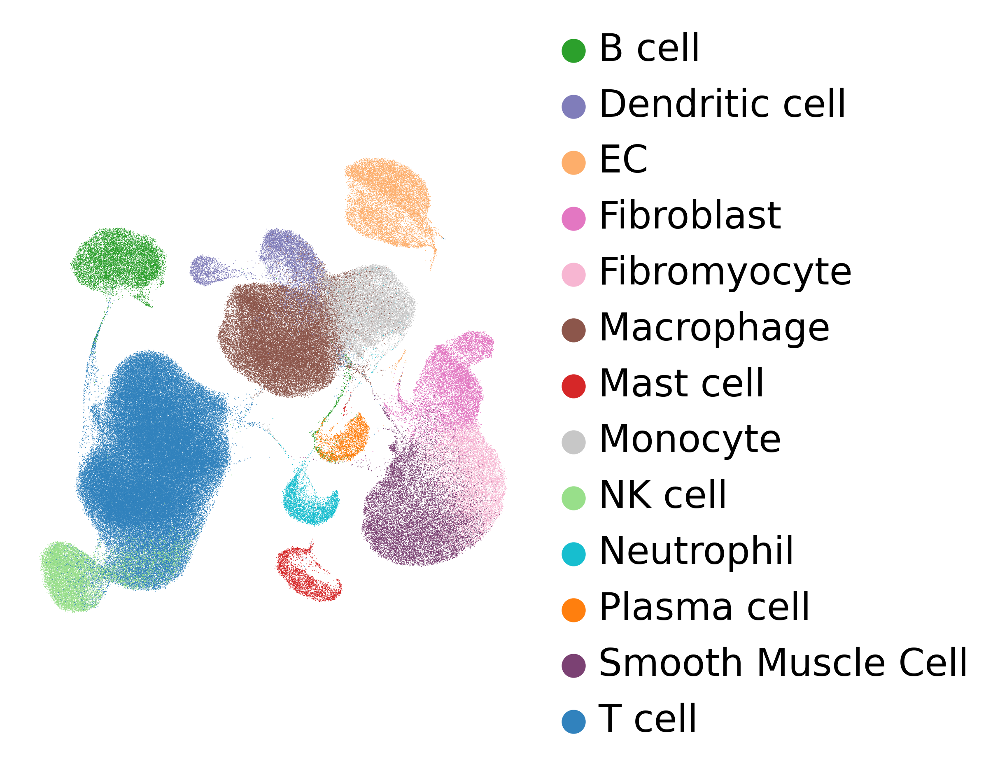

In [12]:
# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full_filtered,
    color='cell_type_level1_combined',
    palette=color_palette_level1,
    show=True,
    frameon=False,
    title = "",
    #save="Big-Atlas-corrected2-level1.pdf"
)

In [5]:
# Define a new color palette for the origins
origin_colors1 = {
    'carotid': '#1f77b4',   # blue
    'femoral': '#2ca02c',   # green
    'coronary': '#ff7f0e'   # orange
}

In [6]:
# Define a new color palette for the datasets
origin_colors = {
    "Alsaigh": "#1E73BE",  # Blue
    "Chowdhury": "#FF7F00",  # Orange
    "Dib": "#228B22",  # Green
    "Emoto": "#D62728",  # Red
    "Fernandez": "#9467BD",  # Purple
    "Jaiswal": "#8B4513",  # Brown
    "Pan": "#FF69B4",  # Pink
    "Pauli": "#BDB76B",  # Olive
    "Slysz": "#00CED1",  # Turquoise
    "Slysz_femoral": "#ADD8E6",  # Light Blue
    "Wirka": "#FFB347",  # Peach
    "Bashore": "#FFD700"  # Gold (distinct yellow)
}

In [7]:
sorting_dict = {
    "Emoto": "CD45+",
    "Wirka": "unsorted",
    "Chowdhury" : "Only T-cells",
    "Fernandez" : "CD45+",
    "Alsaigh": "unsorted",
    "Pan": "unsorted",
    "Pauli" : "unsorted",
    "Dib": "CD45+",
    "Slysz": "CD45+",
    "Slysz_femoral" : "CD45+",
    "Jaiswal": "CD45+",
    "Bashore": "unsorted"
}

In [9]:
dataset_renaming_dict = {
    "Roche": "Pauli",
    "Emoto_ACS": "Emoto",
    "Emoto_SAP": "Emoto"
}

In [10]:
adata_latent_full_filtered.obs['dataset'] = adata_latent_full_filtered.obs['dataset'].map(lambda x: dataset_renaming_dict.get(x, x))

In [11]:
origin_mapping_dict = {
    'Pauli':"carotid",
    'Alsaigh':"carotid",
    'Fernandez':"carotid",
    'Wirka':"coronary",
    'Emoto':"coronary",
    'Chowdhury':"coronary",
    'Pan': "carotid",
    'Dib':"carotid",
    'Slysz':"carotid",
    'Slysz_femoral':"femoral",
    'Jaiswal':"carotid",
    'Bashore': "carotid"
}

In [12]:
adata_latent_full_filtered.obs['origin'] = adata_latent_full_filtered.obs['dataset'].map(origin_mapping_dict).fillna("no map")

In [13]:
adata_latent_full_filtered.obs['sorting'] = adata_latent_full_filtered.obs['dataset'].map(sorting_dict).fillna("no map")

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


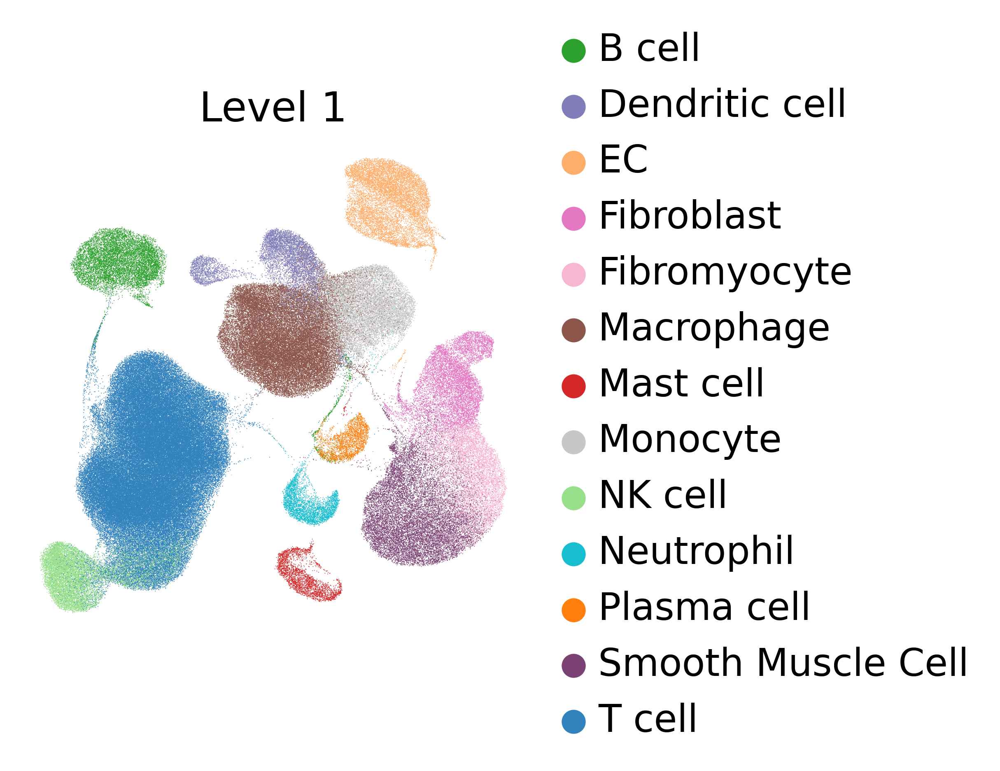

In [24]:
# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full_filtered,
    color='cell_type_level1_combined',
    palette=color_palette_level1,
    show=True,
    frameon=False,
    title = "Level 1",
    save="Big-Atlas-corrected2-level1-withbashore.pdf"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


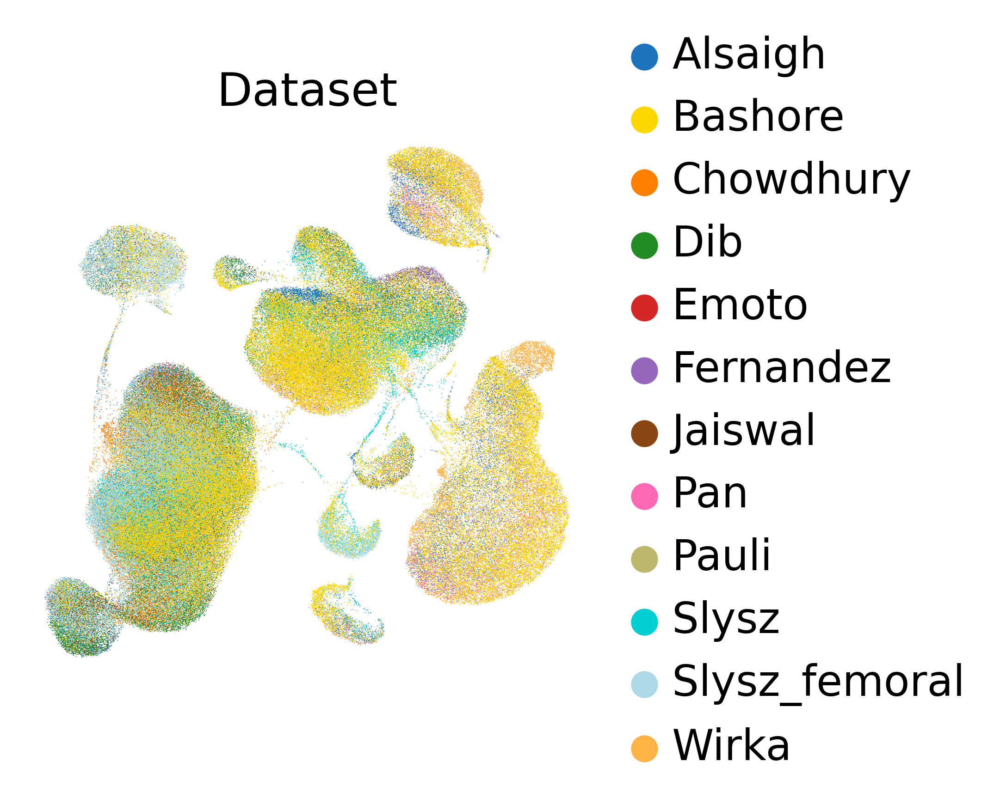

In [21]:
sc.pl.umap(
    adata_latent_full_filtered,
    color='dataset',
    show=True,
    frameon=False,
    palette=origin_colors,
    vmax=1,
    title="Dataset",
    save="_mse3-reload_dataset-corrected2-withbashore.pdf"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


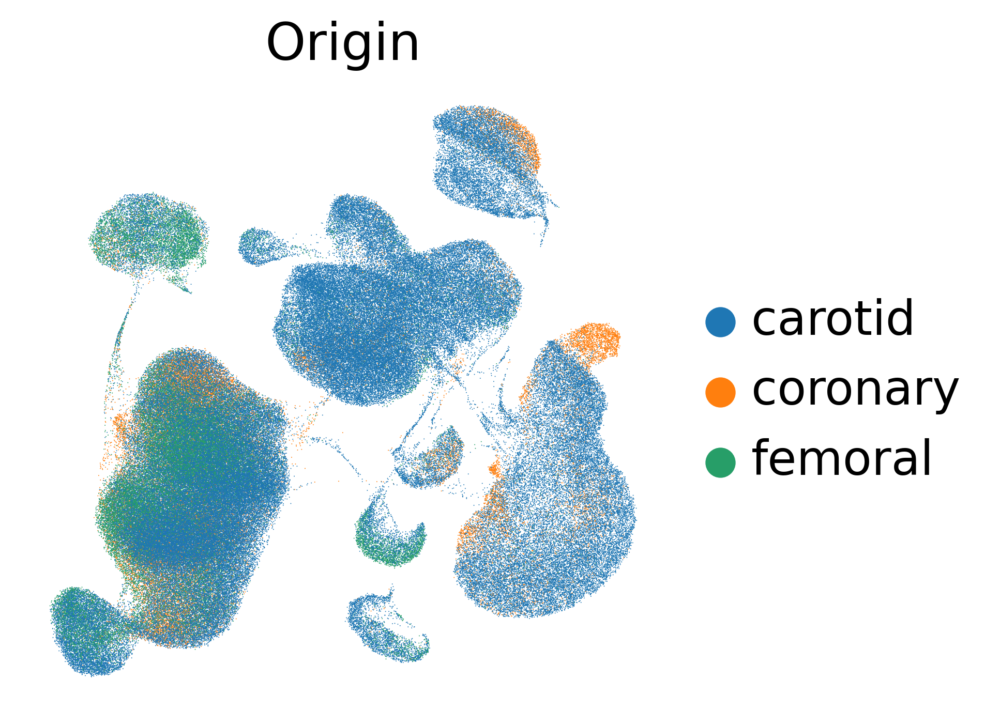

In [22]:
sc.pl.umap(
    adata_latent_full_filtered,
    color='origin',
    show=True,
    frameon=False,
    #cmap='magma',
    vmax=1,
    title="Origin",
    save="_mse3-reload_origin-corrected2-withbashore.pdf"
)

/tmp/ipykernel_103533/1884132594.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_counts = df_sorting.groupby(['origin', 'cell_type_level1']).size().unstack(fill_value=0)
/tmp/ipykernel_103533/1884132594.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_counts = df_sorting.groupby(['origin', 'cell_type_level1']).size().unstack(fill_value=0)
/tmp/ipykernel_103533/1884132594.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and si

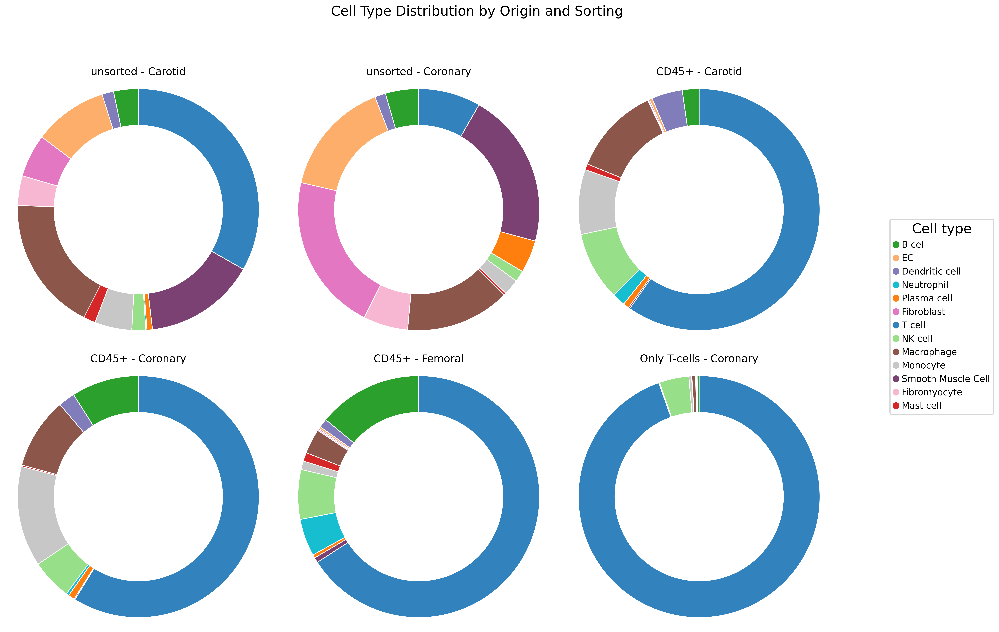

In [27]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# Get the unique sorting values
sorting_values = adata_latent_full_filtered.obs['sorting'].unique()

# Initialize a list to collect plotting data
plots_data = []

# Collect data for plotting
for sorting_value in sorting_values:
    # Filter the data for the current sorting value
    df_sorting = adata_latent_full_filtered.obs[adata_latent_full_filtered.obs['sorting'] == sorting_value][['origin', 'cell_type_level1']]
    
    # Count occurrences of each cell type per origin
    cell_counts = df_sorting.groupby(['origin', 'cell_type_level1']).size().unstack(fill_value=0)
    
    # Normalize counts to get proportions (relative abundance) for each cell type per origin
    cell_abundance_by_origin = cell_counts.div(cell_counts.sum(axis=1), axis=0)
    
    # Iterate over each origin for the current sorting value
    for origin in cell_abundance_by_origin.index:
        data = cell_abundance_by_origin.loc[origin]
        data = data[data > 0]  # Remove zero values to avoid plotting empty slices
        cell_types_in_data = data.index.intersection(color_palette_level1.keys())
        data = data[cell_types_in_data]
        if not data.empty:
            plots_data.append((sorting_value, origin, data))

# Total number of plots required
total_plots = len(plots_data)

# Define rows and columns for the grid layout
nrows = 2  # Adjust as needed for visual clarity
ncols = (total_plots + nrows - 1) // nrows

# Set up the figure
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(6 * ncols, 6 * nrows))

# Ensure axes is a flat array
if total_plots == 1:
    axes = [axes]
else:
    axes = axes.flatten()

# Plot the data
for ax_index, (sorting_value, origin, data) in enumerate(plots_data):
    ax = axes[ax_index]
    
    # Plot the pie chart without percentages
    wedges, texts = ax.pie(
        data,
        labels=None,
        startangle=90,
        colors=[color_palette_level1[cell_type] for cell_type in data.index],
        wedgeprops={'linewidth': 1, 'edgecolor': 'white'},
        textprops={'fontsize': 10}
    )
    
    # Add a circle at the center to make it a donut chart
    centre_circle = plt.Circle((0, 0), 0.70, fc='white')
    ax.add_artist(centre_circle)
    
    # Set title and aspect ratio
    ax.set_title(f'{sorting_value} - {origin.capitalize()}', fontsize=14)
    ax.axis('equal')  # Ensure pie is a circle

# Hide any unused subplots
if len(axes) > total_plots:
    for ax in axes[total_plots:]:
        ax.axis('off')  # Hide the unused subplots

# Add an overall title
fig.suptitle('Cell Type Distribution by Origin and Sorting', fontsize=18)

# Create a custom legend with circular markers for cell types
# Collect all cell types used in the plots
all_cell_types_in_plots = set()
for _, _, data in plots_data:
    all_cell_types_in_plots.update(data.index)

cell_type_handles = [
    Line2D([0], [0], marker='o', color='w', markerfacecolor=color_palette_level1[ct], markersize=10, label=ct)
    for ct in all_cell_types_in_plots if ct in color_palette_level1
]
fig.legend(handles=cell_type_handles, title='Cell type', bbox_to_anchor=(0.92, 0.5), loc='center left', fontsize=12)

# Adjust layout and save the figure
plt.tight_layout(rect=[0, 0, 0.88, 0.95])  # Adjust to add more space on the right
plt.savefig("figures/origin_abundances_sorted-corrected2-withbashore.pdf", dpi=600, bbox_inches="tight")
#plt.show()

In [28]:
from matplotlib.lines import Line2D
from matplotlib.patches import Patch 

In [33]:
# Convert 'origin' and 'cell_type_level1' data into a DataFrame for easier manipulation
df = adata_latent_full_filtered.obs[['origin', 'cell_type_level1_combined']]

# Count occurrences of each cell type per origin
cell_counts = df.groupby(['origin', 'cell_type_level1_combined']).size().unstack(fill_value=0)

# Normalize counts to get proportions (relative abundance) for each cell type per origin
cell_abundance_by_origin = cell_counts.div(cell_counts.sum(axis=1), axis=0)
cell_abundance_by_cell_type = cell_counts.div(cell_counts.sum(axis=0), axis=1)

/tmp/ipykernel_103533/1785693128.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_counts = df.groupby(['origin', 'cell_type_level1_combined']).size().unstack(fill_value=0)


In [34]:
cell_abundance_by_cell_type

cell_type_level1_combined,B cell,Dendritic cell,EC,Fibroblast,Fibromyocyte,Macrophage,Mast cell,Monocyte,NK cell,Neutrophil,Plasma cell,Smooth Muscle Cell,T cell
origin,,,,,,,,,,,,,
carotid,0.445831,0.912008,0.83838,0.745859,0.907903,0.918754,0.846206,0.928433,0.71960,0.540331,0.72343,0.831753,0.620416
coronary,0.071087,0.030708,0.15384,0.248090,0.084957,0.050389,0.016189,0.040906,0.09256,0.003878,0.21256,0.153245,0.189723
femoral,0.483081,0.057284,0.00778,0.006051,0.007140,0.030857,0.137605,0.030661,0.18784,0.455791,0.06401,0.015002,0.189861


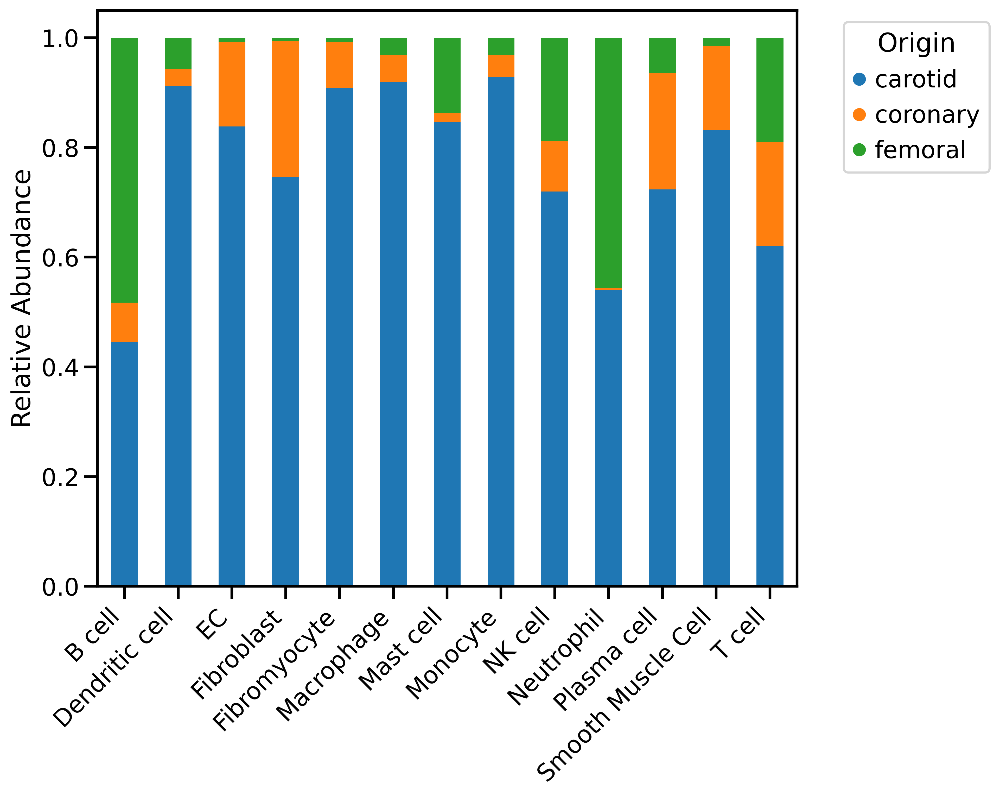

In [46]:
# Set up the figure
fig = plt.figure(figsize=(10, 8))  # Adjusted figure size
ax = fig.add_subplot(111)  # Single subplot for the bar chart

# Plot: Stacked bar plot of origin abundance per cell type
cell_abundance_by_cell_type.T.plot(
    kind='bar',
    stacked=True,
    color=[origin_colors1.get(origin) for origin in cell_abundance_by_cell_type.index],
    ax=ax
)

plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

# Formatting the plot
ax.set_xlabel('')
ax.set_ylabel('Relative Abundance')
ax.grid(False)
ax.set_yticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])  # Set y-axis ticks

# Create custom legend handles with circles for origins
origin_labels = cell_abundance_by_cell_type.index
origin_colors_list = [origin_colors1.get(origin) for origin in origin_labels]
origin_handles = [
    Line2D(
        [0], [0], marker='o', color='w', label=label,
        markerfacecolor=color, markersize=10
    )
    for label, color in zip(origin_labels, origin_colors_list)
]

# Position the legend
ax.legend(
    handles=origin_handles, title='Origin',
    bbox_to_anchor=(1.05, 1), loc='upper left'
)

# Adjust layout and display the figure
plt.tight_layout()
plt.savefig("figures/Origin_abundances_corrected2-celltypes-withbashore.pdf", dpi=600, bbox_inches="tight")
#plt.show()

/tmp/ipykernel_103533/4110907859.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_counts = df.groupby(['dataset', 'cell_type_level1_combined']).size().unstack(fill_value=0)


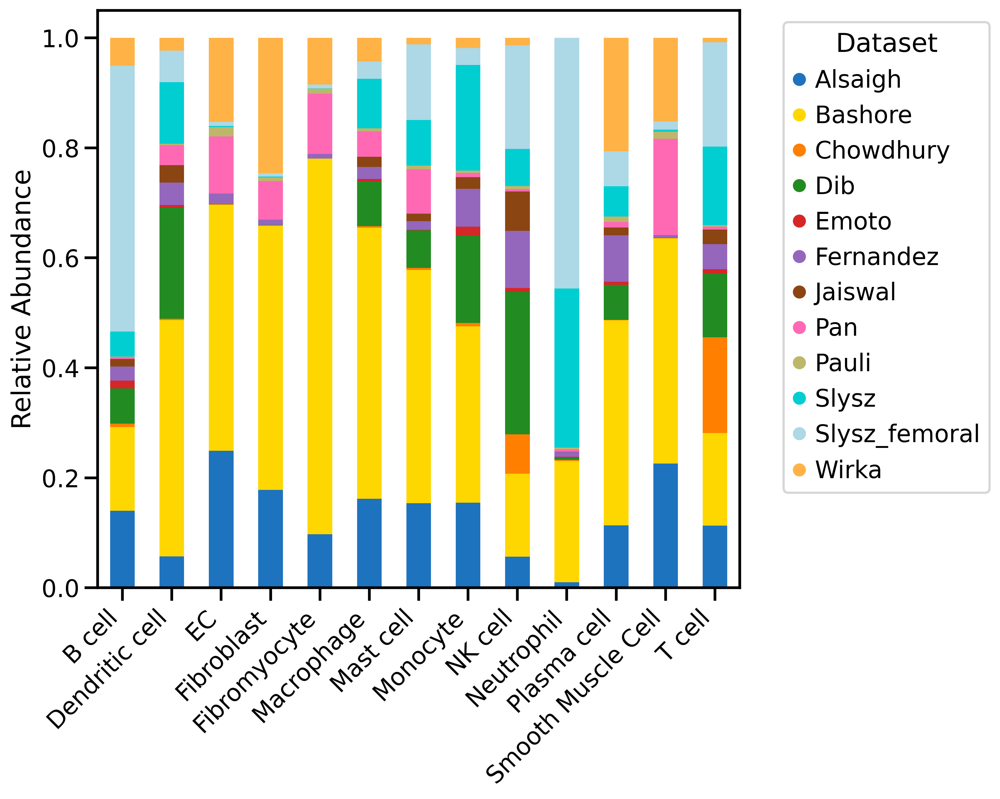

In [51]:
# Convert 'dataset' and 'cell_type_level1_combined' data into a DataFrame for easier manipulation
df = adata_latent_full_filtered.obs[['dataset', 'cell_type_level1_combined']]

# Count occurrences of each cell type per dataset
cell_counts = df.groupby(['dataset', 'cell_type_level1_combined']).size().unstack(fill_value=0)

# Normalize counts to get proportions (relative abundance) for each cell type per dataset
cell_abundance_by_dataset = cell_counts.div(cell_counts.sum(axis=1), axis=0)
cell_abundance_by_cell_type = cell_counts.div(cell_counts.sum(axis=0), axis=1)

# Set up the figure
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111)

# Plot: Stacked bar plot of dataset abundance per cell type
cell_abundance_by_cell_type.T.plot(
    kind='bar',
    stacked=True,
    color=[origin_colors.get(ds) for ds in cell_abundance_by_cell_type.index],
    ax=ax
)

# Rotate x-axis labels
plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

# Formatting the plot
ax.set_xlabel('')
ax.set_ylabel('Relative Abundance')
ax.grid(False)
ax.set_yticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])  # Set y-axis ticks

# Create custom legend handles with circles for datasets
dataset_labels = cell_abundance_by_cell_type.index
dataset_colors_list = [origin_colors.get(ds) for ds in dataset_labels]
dataset_handles = [
    Line2D(
        [0], [0], marker='o', color='w', label=label,
        markerfacecolor=color, markersize=10
    )
    for label, color in zip(dataset_labels, dataset_colors_list)
]

# Position the legend
ax.legend(
    handles=dataset_handles, title='Dataset',
    bbox_to_anchor=(1.05, 1), loc='upper left'
)

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig("figures/Dataset_abundances_corrected2-celltypes-withbashore.pdf", dpi=600, bbox_inches="tight")
#plt.show()

/tmp/ipykernel_350633/471503717.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_counts = df.groupby(['dataset', 'cell_type_level1_combined']).size().unstack(fill_value=0)


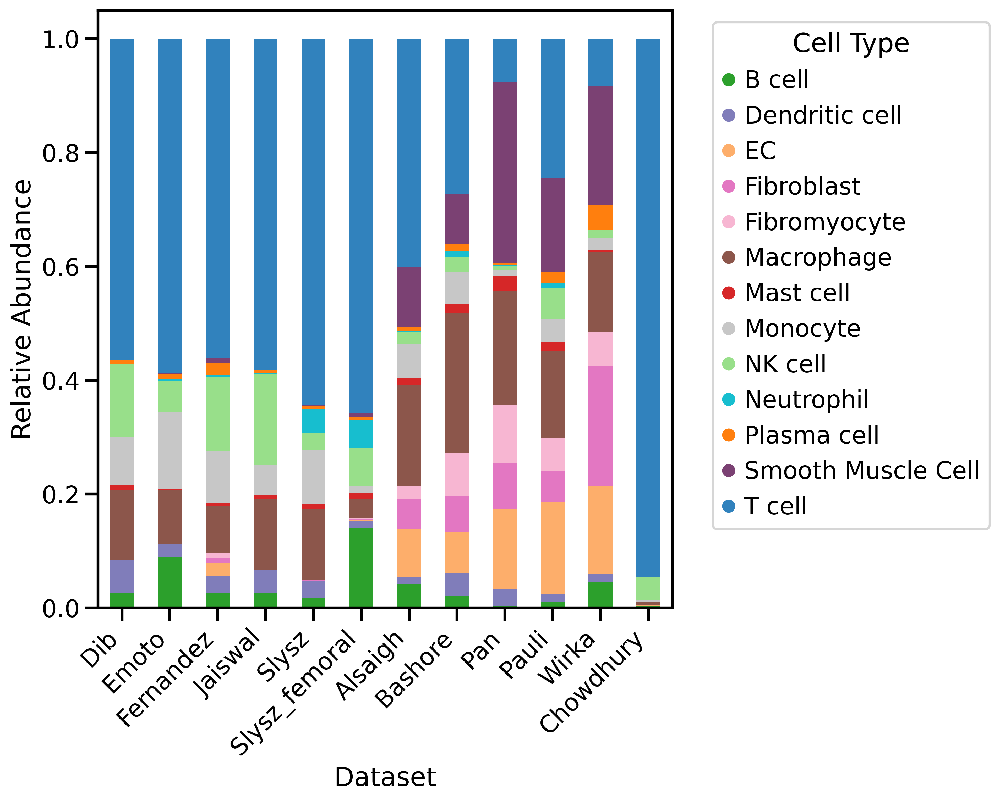

In [17]:
# Define the order of groups
group_order = ["CD45+", "unsorted", "Only T-cells"]

# Convert 'dataset' and 'cell_type_level1_combined' data into a DataFrame
df = adata_latent_full_filtered.obs[['dataset', 'cell_type_level1_combined']]

# Count occurrences of each cell type per dataset
cell_counts = df.groupby(['dataset', 'cell_type_level1_combined']).size().unstack(fill_value=0)

# Normalize counts to get proportions (relative abundance) for each cell type per dataset
cell_abundance_by_dataset = cell_counts.div(cell_counts.sum(axis=1), axis=0)

# Sort the dataset index according to the group order defined in sorting_dict
ordered_datasets = sorted(
    cell_abundance_by_dataset.index,
    key=lambda x: (group_order.index(sorting_dict[x]), x)
)
cell_abundance_by_dataset = cell_abundance_by_dataset.reindex(ordered_datasets)

# Set up the figure
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111)

# Use the provided color palette for cell types
colors = [color_palette_level1[ct] for ct in cell_abundance_by_dataset.columns]

# Plot: Stacked bar plot of cell types per dataset with the new order
cell_abundance_by_dataset.plot(
    kind='bar',
    stacked=True,
    color=colors,
    ax=ax
)

# Rotate x-axis labels
plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

# Formatting the plot
ax.set_xlabel('Dataset')
ax.set_ylabel('Relative Abundance')
ax.grid(False)
ax.set_yticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])  # Set y-axis ticks

# Create custom legend handles for cell types
cell_type_labels = cell_abundance_by_dataset.columns
cell_type_handles = [
    Line2D(
        [0], [0], marker='o', color='w', label=ct,
        markerfacecolor=color_palette_level1[ct], markersize=10
    )
    for ct in cell_type_labels
]

# Position the legend
ax.legend(
    handles=cell_type_handles, title='Cell Type',
    bbox_to_anchor=(1.05, 1), loc='upper left'
)

# Adjust layout and save the figure
plt.tight_layout()
#plt.savefig("figures/Celltype_abundances_reversed_grouped.pdf", dpi=600, bbox_inches="tight")
plt.show()

In [56]:
df = adata_latent_full_filtered.obs[['dataset', 'cell_type_level1_combined', 'sorting', 'origin', 'sample']]

In [61]:
# Step 1: Group and calculate cell counts
cell_counts = df.groupby(['sample', 'cell_type_level1_combined']).size().unstack(fill_value=0)

# Step 2: Extract unique origin and dataset values for each sample
# (assuming origin and dataset are consistent for each sample)
origin_dataset = df[['sample', 'origin', 'dataset', 'sorting']].drop_duplicates().set_index('sample')

# Step 3: Merge the origin and dataset information into cell_counts
cell_counts = cell_counts.merge(origin_dataset, left_index=True, right_index=True)

# The cell_counts DataFrame now has origin and dataset as additional columns

/tmp/ipykernel_350633/1656263732.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_counts = df.groupby(['sample', 'cell_type_level1_combined']).size().unstack(fill_value=0)


In [62]:
cell_counts

,B cell,Dendritic cell,EC,Fibroblast,Fibromyocyte,Macrophage,Mast cell,Monocyte,NK cell,Neutrophil,Plasma cell,Smooth Muscle Cell,T cell,origin,dataset,sorting
sample,,,,,,,,,,,,,,,,
1_2_3_Slysz_femoral,64,131,0,0,0,167,0,176,157,3,1,1,1335,femoral,Slysz_femoral,CD45+
1_2_Slysz,123,574,4,0,0,850,65,1500,476,155,42,1,3147,carotid,Slysz,CD45+
1_Alsaigh,4,186,800,181,133,3475,75,1090,327,8,39,1010,2768,carotid,Alsaigh,unsorted
1_Chowdhury,3,0,0,0,0,0,1,0,357,0,1,0,3549,coronary,Chowdhury,Only T-cells
1_Dib,184,133,0,0,0,281,14,177,536,1,1,0,2439,carotid,Dib,CD45+
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17_Bashore,20,112,309,488,714,1367,77,135,101,33,40,1244,1320,carotid,Bashore,unsorted
18_Bashore,98,99,381,101,147,731,48,134,179,86,124,194,2046,carotid,Bashore,unsorted
19_Bashore,54,137,393,382,270,1253,39,236,108,22,47,267,1411,carotid,Bashore,unsorted


In [63]:
cell_counts.to_csv("sample_celltype_abundance.csv") # used for suppl figure 7

# Validations

In [3]:
adata_latent_full_filtered = sc.read_h5ad("Big-Atlas-withBashore-corrected2-embed-nouncert.h5ad") 

In [4]:
# get only bashore dataset
adata_bashore = adata_latent_full_filtered[adata_latent_full_filtered.obs['cell_type_pred_ref'] != "Reference"]

In [5]:
adata_bashore.obs.index = adata_bashore.obs.index.str[:-2]

In [6]:
adata_bashore.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,...,n_genes,n_counts,size_factors,cell_type_level1,conditions_combined,cell_type_pred,cell_type_uncert,query,cell_type_pred_ref,cell_type_level1_combined
AAACCCACAATCACGT-1_4,Bashore,NaN,823.0,1718.0,74.0,4.307334,4_Bashore,NaN,NaN,NaN,...,823.0,1718.0,0.264432,unknown,4_Bashore,Fibroblast,0.096466,1,Fibroblast,Fibroblast
AAACCCACAGGAGGAG-1_4,Bashore,NaN,2643.0,9332.0,228.0,2.443206,4_Bashore,NaN,NaN,NaN,...,2643.0,9332.0,1.256337,unknown,4_Bashore,Fibromyocyte,0.047213,1,Fibromyocyte,Fibromyocyte
AAACCCATCGACTCCT-1_4,Bashore,NaN,1406.0,2599.0,94.0,3.616776,4_Bashore,NaN,NaN,NaN,...,1406.0,2599.0,0.441393,unknown,4_Bashore,Smooth Muscle Cell,0.028907,1,Smooth Muscle Cell,Smooth Muscle Cell
AAACGAAAGTGGTGAC-1_4,Bashore,NaN,3025.0,11552.0,482.0,4.172438,4_Bashore,NaN,NaN,NaN,...,3025.0,11552.0,1.613101,unknown,4_Bashore,Fibromyocyte,0.065447,1,Fibromyocyte,Fibromyocyte
AAACGAACACTCCACT-1_4,Bashore,NaN,4844.0,25671.0,2441.0,9.508784,4_Bashore,NaN,NaN,NaN,...,4844.0,25671.0,4.361089,unknown,4_Bashore,Smooth Muscle Cell,0.048402,1,Smooth Muscle Cell,Smooth Muscle Cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTGTTAGGCTT-1_12,Bashore,NaN,3987.0,15946.0,485.0,3.041515,12_Bashore,NaN,NaN,NaN,...,3987.0,15945.0,2.364527,unknown,12_Bashore,Fibromyocyte,0.040923,1,Fibromyocyte,Fibromyocyte
TTTGTTGCAACTGCCG-1_12,Bashore,NaN,5827.0,27851.0,791.0,2.840113,12_Bashore,NaN,NaN,NaN,...,5827.0,27851.0,5.816382,unknown,12_Bashore,EC,0.068158,1,EC,EC
TTTGTTGGTAGTCTGT-1_12,Bashore,NaN,3065.0,10611.0,578.0,5.447177,12_Bashore,NaN,NaN,NaN,...,3065.0,10611.0,1.486614,unknown,12_Bashore,Smooth Muscle Cell,0.041877,1,Smooth Muscle Cell,Smooth Muscle Cell
TTTGTTGGTTACCGTA-1_12,Bashore,NaN,2825.0,7735.0,629.0,8.131868,12_Bashore,NaN,NaN,NaN,...,2825.0,7735.0,1.390295,unknown,12_Bashore,Smooth Muscle Cell,0.046397,1,Smooth Muscle Cell,Smooth Muscle Cell


In [8]:
adata_bashore_counts = sc.read_h5ad("bashore-aggr-QC-log-normalized.h5ad")

In [9]:
common_barcodes = adata_bashore.obs.index.intersection(adata_bashore_counts.obs.index)

In [10]:
# Subset both AnnData objects to the common barcodes
adata_bashore = adata_bashore[common_barcodes].copy()
adata_bashore_counts = adata_bashore_counts[common_barcodes].copy()

In [11]:
level1 = adata_bashore.obs["cell_type_level1_combined"].values

In [12]:
adata_bashore_counts.obs["cell_type_level1"] = level1

In [13]:
adata_bashore_counts

AnnData object with n_obs × n_vars = 75663 × 28599
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'
    uns: 'log1p'

In [30]:
adata_bashore_counts.write('tmp/bashore-annot_allgenes_log1pnormalized_corrected2.h5ad')

In [7]:
annot_adata = sc.read_h5ad('tmp/bashore-annot_allgenes_log1pnormalized_corrected2.h5ad')

In [32]:
annot_adata.obs

,sample,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,n_counts,dataset,size_factors,cell_type_level1
AAACCCACAATCACGT-1_4,4_Bashore,823,1718.0,74.0,4.307334,823,1718.0,Bashore,0.264432,Fibroblast
AAACCCACAGGAGGAG-1_4,4_Bashore,2643,9332.0,228.0,2.443206,2643,9332.0,Bashore,1.256337,Fibromyocyte
AAACCCATCGACTCCT-1_4,4_Bashore,1406,2599.0,94.0,3.616776,1406,2599.0,Bashore,0.441393,Smooth Muscle Cell
AAACGAAAGTGGTGAC-1_4,4_Bashore,3025,11552.0,482.0,4.172438,3025,11552.0,Bashore,1.613101,Fibromyocyte
AAACGAACACTCCACT-1_4,4_Bashore,4844,25671.0,2441.0,9.508784,4844,25671.0,Bashore,4.361089,Smooth Muscle Cell
...,...,...,...,...,...,...,...,...,...,...
TTTGGTTGTTAGGCTT-1_12,12_Bashore,3987,15946.0,485.0,3.041515,3987,15945.0,Bashore,2.364527,Fibromyocyte
TTTGTTGCAACTGCCG-1_12,12_Bashore,5827,27851.0,791.0,2.840113,5827,27851.0,Bashore,5.816382,EC
TTTGTTGGTAGTCTGT-1_12,12_Bashore,3065,10611.0,578.0,5.447177,3065,10611.0,Bashore,1.486614,Smooth Muscle Cell
TTTGTTGGTTACCGTA-1_12,12_Bashore,2825,7735.0,629.0,8.131868,2825,7735.0,Bashore,1.390295,Smooth Muscle Cell


In [14]:
# read in author provided cell types
bashore_annotations = pd.read_csv("carotid_celltype_annotation.txt", sep="\t")
bashore_annotations

,cell_id,sample,cluster
0,RPE008-AAACCCAAGACAAGCC-1-0,adata_RPE008,Fibroblast
1,RPE008-AAACCCACAAGCCATT-1-0,adata_RPE008,pDC
2,RPE008-AAACCCATCCTTGGAA-1-0,adata_RPE008,CD8+ T Cell 2
3,RPE008-AAACGAAAGTCGAATA-1-0,adata_RPE008,CD4+ T Cell 1
4,RPE008-AAACGAACAGCTTTCC-1-0,adata_RPE008,Fibroblast
...,...,...,...
88088,TTTGGAGGTAACATAG-1-14,adata_RPE034,Fibroblast
88089,TTTGGAGGTGACATCT-1-14,adata_RPE034,CD8+ T Cell 1
88090,TTTGGTTCACCACATA-1-14,adata_RPE034,Macrophage 2
88091,TTTGGTTCAGTCGCAC-1-14,adata_RPE034,Macrophage 1


In [15]:
# remove sample 1,2 and 3 aka RPE004, RPE005, RPE006 because not part of the bashore GSE (but from GSE155512).
bashore_annotations = bashore_annotations[~bashore_annotations['sample'].isin(['adata_RPE004', 'adata_RPE005', 'adata_RPE006'])]

In [16]:
def modify_cell_id(cell_id):
    if cell_id.startswith('R'):
        return cell_id[7:]
    return cell_id

bashore_annotations['cell_id'] = bashore_annotations['cell_id'].apply(modify_cell_id)

/tmp/ipykernel_3636549/1427025835.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bashore_annotations['cell_id'] = bashore_annotations['cell_id'].apply(modify_cell_id)


In [17]:
carotid_mapping = {
    "adata_RPE004": "1",
    "adata_RPE005": "2",
    "adata_RPE006": "3",
    "adata_RPE008": "5",
    "adata_RPE010": "7",
    "adata_RPE012": "8",
    "adata_RPE014": "10",
    "adata_RPE015": "11",
    "adata_RPE016": "12",
    "adata_RPE007": "4",
    "adata_RPE009": "6",
    "adata_RPE013": "9",
    "adata_RPE020": "13",
    "adata_RPE022": "14",
    "adata_RPE026": "15",
    "adata_RPE027": "16",
    "adata_RPE029": "17",
    "adata_RPE031A": "18",
    "adata_RPE032": "19",
    "adata_RPE033": "20",
    "adata_RPE034": "21"
}
# Function to modify the cell_id based on the sample
def modify_cell_id(row):
    sample = row['sample']
    new_number = carotid_mapping.get(sample, None)
    if new_number is not None:
        parts = row['cell_id'].rsplit('-', 1)
        return f"{parts[0]}_{new_number}"
    return row['cell_id']

bashore_annotations['cell_id_new'] = bashore_annotations.apply(modify_cell_id, axis=1)

/tmp/ipykernel_3636549/246168447.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bashore_annotations['cell_id_new'] = bashore_annotations.apply(modify_cell_id, axis=1)


In [18]:
in_bashore = annot_adata.obs_names.isin(bashore_annotations['cell_id_new'].values)

In [19]:
not_in_bashore = annot_adata.obs_names[~in_bashore].tolist()

In [20]:
bashore_mapping_dict = {
    "Macrophage": ["Macrophage 1", "Macrophage 2", "Macrophage 3", "Macrophage 4", "Macrophage 5"],
    "Fibroblast": ["Fibroblast"],
    "T cell": ["CD4+ T Cell 1", "CD8+ T Cell 1", "CD4+ T Cell 2", "CD8+ T Cell 2", "CD4+ T Cell 3"],
    "Smooth Muscle Cell": ["SMC 1", "SMC 2", "SMC 3", "Modulated SMC"], 
    "EC": ["Endothelial Cell 1", "Endothelial Cell 2"],
    "NK cell": ["NK Cell"],
    "Mast cell": ["Mast Cell"],
    "B cell": ["B Cell 1", "B Cell 2"],
    "Plasma cell": ["Plasma Cell"],
    "Neutrophil": ["Neutrophil"],
    "Dendritic cell": ["pDC", "cDC"]
}

In [21]:
cell_id_to_cluster = dict(zip(bashore_annotations['cell_id_new'], bashore_annotations['cluster']))

In [22]:
annot_adata.obs['cell_type'] = annot_adata.obs_names.map(lambda x: cell_id_to_cluster.get(x, 'unknown'))

In [23]:
adata_bashore = annot_adata.copy()

In [24]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
import matplotlib.colors as colors

In [25]:
cell_types_bashore = list(adata_bashore.obs["cell_type"].values)

In [26]:
# Invert the bashore_mapping_dict
inverted_bashore_mapping = {v: k for k, values in bashore_mapping_dict.items() for v in values}

# Map each cell type in cell_types, keeping the original value if it's not in the mapping
mapped_cell_types_bashore = [inverted_bashore_mapping.get(cell_type, cell_type) for cell_type in cell_types_bashore]

In [27]:
cell_types_pred_bashore = list(adata_bashore.obs["cell_type_level1"].values)

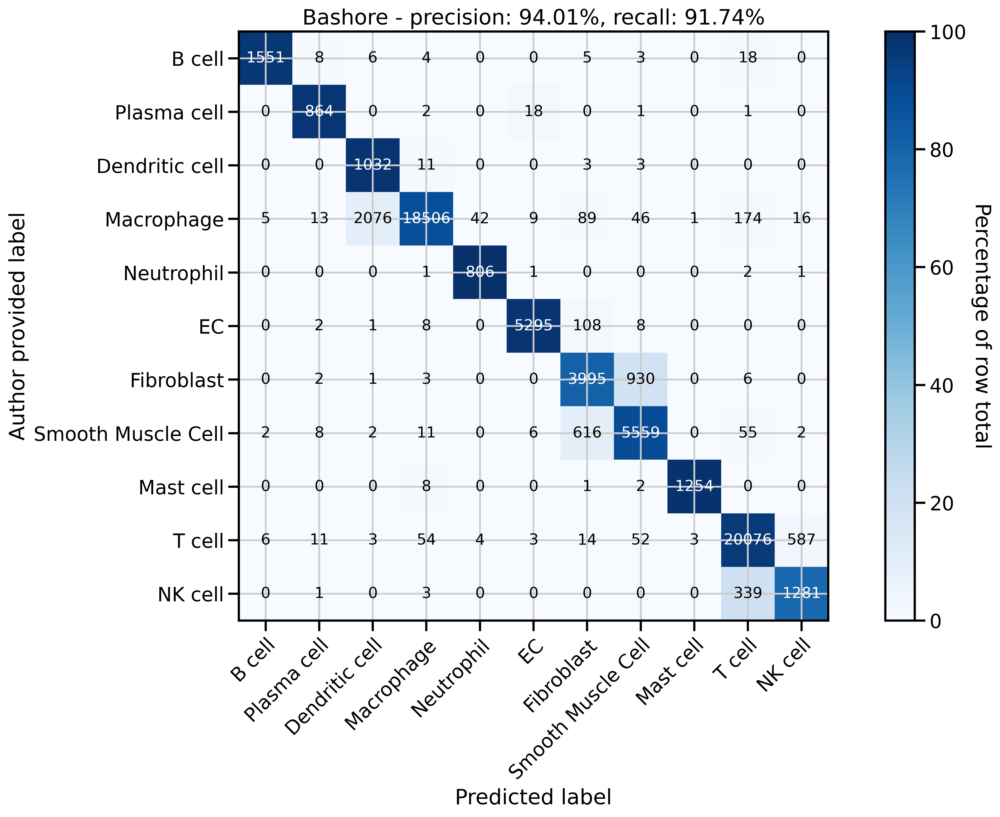

In [50]:
# Define the new order for the cell types
new_order = ["B cell", "Plasma cell", "Dendritic cell", "Macrophage", "Neutrophil" ,"EC", "Fibroblast", "Smooth Muscle Cell", "Mast cell", "T cell", "NK cell"]

# Find the intersection of unique cell types in both lists and filter them according to the new order
common_cell_types_bashore = set(mapped_cell_types_bashore) & set(cell_types_pred_bashore)
common_cell_types_bashore = [ct for ct in new_order if ct in common_cell_types_bashore]

# Filter both lists to include only indices where the cell type of the true labels is in the common set
# and the corresponding predicted cell type is also in the common set.
common_indices = [i for i, ct in enumerate(mapped_cell_types_bashore) if ct in common_cell_types_bashore and cell_types_pred_bashore[i] in common_cell_types_bashore]

# Use the common indices to filter both lists
filtered_mapped_cell_types_bashore = [mapped_cell_types_bashore[i] for i in common_indices]
filtered_cell_types_pred_bashore = [cell_types_pred_bashore[i] for i in common_indices]

# Calculate the confusion matrix and accuracy using the new order
conf_matrix_bashore = confusion_matrix(filtered_mapped_cell_types_bashore, filtered_cell_types_pred_bashore, labels=common_cell_types_bashore)
accuracy_bashore = accuracy_score(filtered_mapped_cell_types_bashore, filtered_cell_types_pred_bashore)

# Calculate precision and recall for each class and overall
precision_bashore = precision_score(filtered_mapped_cell_types_bashore, filtered_cell_types_pred_bashore, labels=common_cell_types_bashore, average=None)
recall_bashore = recall_score(filtered_mapped_cell_types_bashore, filtered_cell_types_pred_bashore, labels=common_cell_types_bashore, average=None)
overall_precision_bashore = precision_score(filtered_mapped_cell_types_bashore, filtered_cell_types_pred_bashore, average='weighted')
overall_recall_bashore = recall_score(filtered_mapped_cell_types_bashore, filtered_cell_types_pred_bashore, average='weighted')

# Calculate percentages for coloring (per row)
row_sums = conf_matrix_bashore.sum(axis=1, keepdims=True)
conf_matrix_percentages = conf_matrix_bashore / row_sums * 100

# Plotting the confusion matrix
fig, ax = plt.subplots(figsize=(15, 10))
norm = colors.Normalize(vmin=0, vmax=100)  # Set vmax to 100 for percentage
im = ax.imshow(conf_matrix_percentages, interpolation='nearest', cmap=plt.cm.Blues, norm=norm)
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.set_ylabel('Percentage of row total', rotation=-90, va="bottom")

ax.set(xticks=np.arange(len(common_cell_types_bashore)),
       yticks=np.arange(len(common_cell_types_bashore)),
       xticklabels=common_cell_types_bashore, yticklabels=common_cell_types_bashore,
       title=f'Bashore - precision: {overall_precision_bashore:.2%}, recall: {overall_recall_bashore:.2%}',
       ylabel='Author provided label',
       xlabel='Predicted label')

plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Add text annotations (showing the original count)
for i in range(conf_matrix_bashore.shape[0]):
    for j in range(conf_matrix_bashore.shape[1]):
        ax.text(j, i, format(conf_matrix_bashore[i, j], 'd'),
                ha="center", va="center", fontsize=13,
                color="white" if conf_matrix_percentages[i, j] > 50 else "black")

fig.tight_layout()
plt.savefig("figures/conf_matrix_common_bashore_mse3-reload-level2-new-labels-row-percentage-color-corrected2.pdf")
#plt.show()

/tmp/ipykernel_3636549/2382676103.py:22: RuntimeWarning: invalid value encountered in divide
  conf_matrix_percentages = conf_matrix_full / row_sums_full * 100


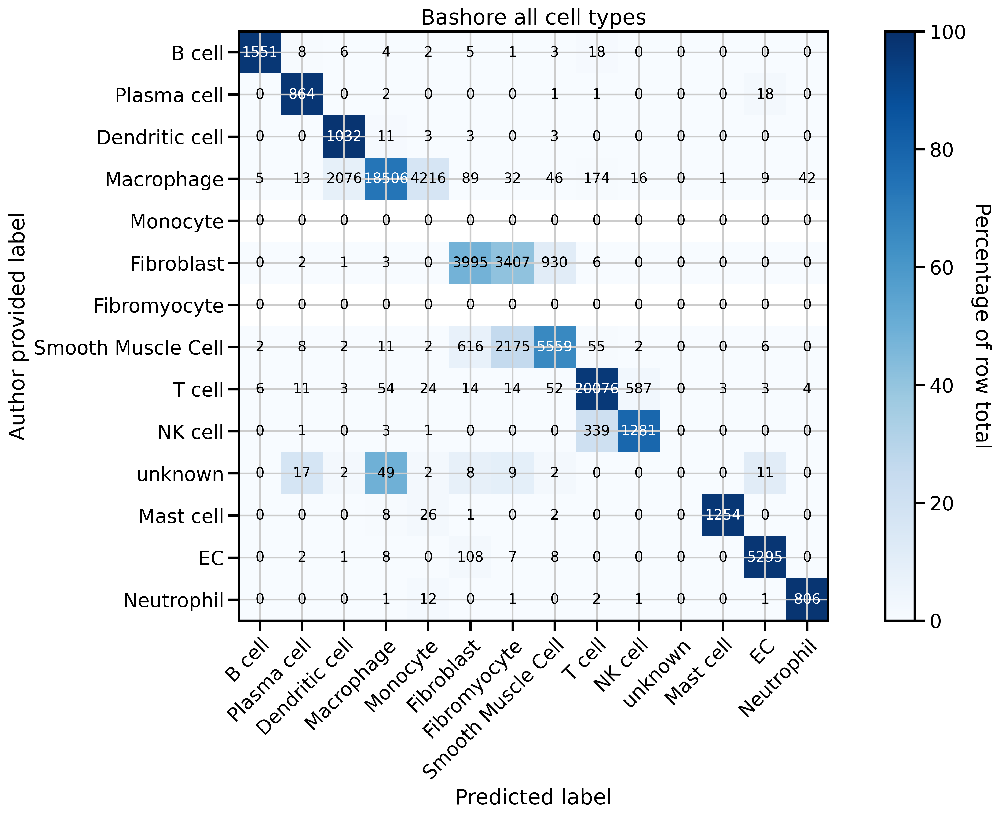

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/tempfile.py:860: ResourceWarning: Implicitly cleaning up <TemporaryDirectory '/tmp/tmp714q7eoh'>
  _warnings.warn(warn_message, ResourceWarning)


In [32]:
# Define the new order for the cell types
new_order = ["B cell", "Plasma cell", "Dendritic cell", "Macrophage", "Monocyte", "Fibroblast", "Fibromyocyte", "Smooth Muscle Cell", "T cell", "NK cell"]

# Get all unique cell types from both lists, ordered by the new order
all_cell_types = sorted(set(mapped_cell_types_bashore) | set(cell_types_pred_bashore), key=lambda x: (x not in new_order, new_order.index(x) if x in new_order else len(new_order)))

# Identify the common cell types present in both lists and in the new order
common_cell_types_bashore = [ct for ct in new_order if ct in set(mapped_cell_types_bashore) & set(cell_types_pred_bashore)]

# Calculate the full confusion matrix using all cell types
conf_matrix_full = confusion_matrix(mapped_cell_types_bashore, cell_types_pred_bashore, labels=all_cell_types)
accuracy_full = accuracy_score(mapped_cell_types_bashore, cell_types_pred_bashore)

# Calculate precision and recall only for common cell types
precision_common = precision_score(mapped_cell_types_bashore, cell_types_pred_bashore, labels=common_cell_types_bashore, average=None)
recall_common = recall_score(mapped_cell_types_bashore, cell_types_pred_bashore, labels=common_cell_types_bashore, average=None)
overall_precision_common = precision_score(mapped_cell_types_bashore, cell_types_pred_bashore, labels=common_cell_types_bashore, average='weighted')
overall_recall_common = recall_score(mapped_cell_types_bashore, cell_types_pred_bashore, labels=common_cell_types_bashore, average='weighted')

# Calculate percentages for coloring each row in the full confusion matrix
row_sums_full = conf_matrix_full.sum(axis=1, keepdims=True)
conf_matrix_percentages = conf_matrix_full / row_sums_full * 100

# Plotting the full confusion matrix with all cell types and percentage coloring
fig, ax = plt.subplots(figsize=(15, 10))
norm = colors.Normalize(vmin=0, vmax=100)  # Set vmax to 100 for percentage
im = ax.imshow(conf_matrix_percentages, interpolation='nearest', cmap=plt.cm.Blues, norm=norm)
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.set_ylabel('Percentage of row total', rotation=-90, va="bottom")

ax.set(xticks=np.arange(len(all_cell_types)),
       yticks=np.arange(len(all_cell_types)),
       xticklabels=all_cell_types, yticklabels=all_cell_types,
       title=f'Bashore all cell types',
       ylabel='Author provided label',
       xlabel='Predicted label')

plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Add text annotations (showing the original count)
for i in range(conf_matrix_full.shape[0]):
    for j in range(conf_matrix_full.shape[1]):
        ax.text(j, i, format(conf_matrix_full[i, j], 'd'),
                ha="center", va="center",
                color="white" if conf_matrix_percentages[i, j] > 50 else "black", fontsize=12)

fig.tight_layout()
plt.savefig("figures/conf_matrix_full_rowpercent_bashore_mse3-reload-level2-corrected2_suppl.pdf")
#plt.show()

In [76]:
cite_adata = sc.read_h5ad("tmp/Bashore_onlyCITE.h5ad")

In [77]:
annot_adata = sc.read_h5ad('tmp/bashore-annot_allgenes_log1pnormalized_corrected2.h5ad')

In [78]:
# Step 1: Intersect barcodes to find common cells in both datasets
common_barcodes = cite_adata.obs_names.intersection(annot_adata.obs_names)

# Filter both datasets to only include common cells
filtered_cite_adata = cite_adata[common_barcodes, :]
filtered_annot_adata = annot_adata[common_barcodes, :]

# Step 2: Transfer the necessary columns from filtered_annot_adata to filtered_cite_adata
# Assuming common_barcodes ensures matching order, check if additional sorting is necessary
filtered_cite_adata.obs['cell_type_level1'] = filtered_annot_adata.obs['cell_type_level1']

/tmp/ipykernel_2817318/3332881188.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  filtered_cite_adata.obs['cell_type_level1'] = filtered_annot_adata.obs['cell_type_level1']


In [79]:
final_adata = filtered_cite_adata.copy()

In [80]:
final_adata.var_names.values

array(['CD44', 'CD11a', 'CD41', 'CD47', 'CD48', 'Beta2-microglobulin',
       'HLA-A_B_C', 'CD7', 'CD57_Recombinant', 'CD325_N-Cadherin',
       'CD162', 'CD86', 'CD8', 'CD45', 'CD31', 'CD27', 'CD102_ICAM-2',
       'CD2', 'CD36', 'CD172a_SIRPalpha', 'CD273_B7-DC_PD-L2', 'CD3',
       'CD33', 'CD49f', 'CD194_CCR4', 'CD16', 'CD25', 'CD20', 'CD146',
       'IgM', 'CD196_CCR6', 'CD103_Integrin_alphaE', 'CD62L', 'HLA-DR',
       'CD1c', 'CD11b', 'CD64', 'CD244_2B4', 'CD235ab', 'CD268_BAFF-R',
       'CD54', 'CD62P_P-Selectin', 'CD43', 'CD29', 'IgD', 'CD22',
       'CD304_Neuropilin-1', 'TCR_Valpha7.2', 'TCR_Vdelta2',
       'CD158e1_KIR3DL1_NKB1', 'CD112_Nectin-2', 'CD40', 'CD123',
       'CD335_NKp46', 'CD69', 'CD13', 'CD305_LAIR1', 'CD252_OX40L',
       'CD155_PVR', 'CD52', 'CD56', 'CD19', 'CD11c', 'CD34', 'CD105',
       'CD4', 'CD14', 'CD5', 'CD366_Tim-3', 'CD272_BTLA', 'CD21', 'CD42b',
       'CD119_IFN-gamma_alpha_chain', 'CD137_4-1BB', 'CD59', 'CD49b',
       'CD61', 'CD98', 'CD55',

In [81]:
surface_markers_figure2 = {
    "B cell": ["CD268_BAFF-R", "CD19", "CD22", "CD20"],
    "DC": ["CD1c", "CD218a_IL-18Ralpha", "CLEC12A", "CD11c", "CD13"], 
    "EC": ["CD144_VE-Cadherin", "CD31", "CD49b", "CD34", "CD201_EPCR"],
    "Fibroblast": ["CD90_Thy1", "CD49a", "CD29", "CD73_Ecto-5p-nucleotidase"],
    "Macrophage": ["CD11b", "CD11c", "CD64", "HLA-E", "CD93", "HLA-A_B_C", "CD13", "CD32", "FolateReceptorBeta", "HLA-DR", "IgLightChainLambda"],
    "Mast cell": ["FcepsilonRIalpha", "CD82", "CD117_c-kit", "IgE"],
    "NK": ["CD57_Recombinant", "CD244_2B4", "CD314_NKG2D"],
    "Neutrophils": ["CD15_SSEA-1", "CD16", "CD66b", "CD177"],
    "Plasma cell": ["CD19", "CD39", "CD38"],
    "SMC": ["CD146", "CD151_PETA-3", "CD49a", "CD29", "CD142", "EGFR"],
    "T cell": ["CD3", "CD28", "CD5", "CD279_PD-1", "CD2", "CD48", "TCR_alphaBeta", "integrinBeta7"]
}

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No dat

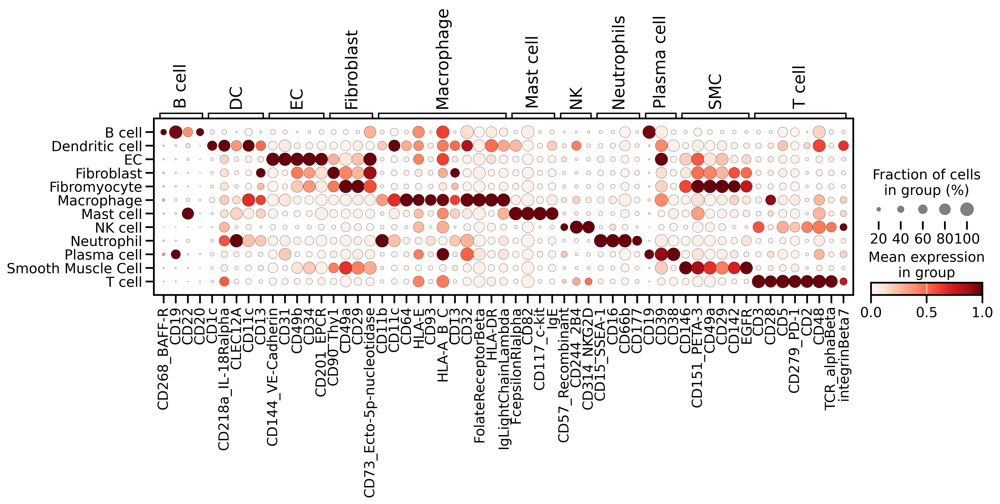

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/tempfile.py:860: ResourceWarning: Implicitly cleaning up <TemporaryDirectory '/tmp/tmpx0oes41m'>
  _warnings.warn(warn_message, ResourceWarning)


In [84]:
dp = sc.pl.dotplot(
    adata = final_adata[final_adata.obs["cell_type_level1"] != "Monocyte"],
    groupby="cell_type_level1",
    var_names=surface_markers_figure2,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    figsize = (16,3.5),
    return_fig = True
)

dp.legend(width=2.2)
#dp.show()
dp.savefig("figures/dotplot_surface_markers_bashore_figure2_curated_new-corrected2.pdf")

# Transfer to all genes

In [67]:
bashore = sc.read_h5ad("bashore_aggr_counts_preint_allgenes.h5ad")

In [68]:
bashore_annot = sc.read_h5ad('tmp/bashore-annot_allgenes_log1pnormalized_corrected2.h5ad')

In [69]:
# Step 1: Subset bashore to include only the cells in bashore_annot
bashore = bashore[bashore_annot.obs_names].copy()

# Step 2: Transfer the "cell_type_level1" column from bashore_annot to bashore
bashore.obs['cell_type_level1'] = bashore_annot.obs['cell_type_level1'].reindex(bashore.obs_names).values

In [70]:
bashore.obs["cell_type_level1"].value_counts()

cell_type_level1
T cell                20671
Macrophage            18660
Smooth Muscle Cell     6606
Fibromyocyte           5646
EC                     5343
Fibroblast             4839
Monocyte               4288
Dendritic cell         3123
NK cell                1887
B cell                 1564
Mast cell              1258
Plasma cell             926
Neutrophil              852
Name: count, dtype: int64

In [71]:
bashore.var['ensembl_id'] = bashore.var.index.values
bashore.var.index = bashore.var['original_gene_names']

In [72]:
bashore.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,original_gene_names,ensembl_id
original_gene_names,,,,,,,,
TSPAN6,False,3055,0.048229,96.271753,3952.0,2922,TSPAN6,ENSG00000000003
TNMD,False,5,0.000061,99.993898,5.0,5,TNMD,ENSG00000000005
DPM1,False,14521,0.222279,82.278929,18214.0,14186,DPM1,ENSG00000000419
SCYL3,False,3850,0.050963,95.301555,4176.0,3742,SCYL3,ENSG00000000457
C1orf112,False,1748,0.022943,97.866784,1880.0,1680,C1orf112,ENSG00000000460
...,...,...,...,...,...,...,...,...
CU633906.5,False,151,0.001892,99.815723,155.0,146,CU633906.5,ENSG00000288187
FAM106C,False,98,0.001196,99.880403,98.0,96,FAM106C,ENSG00000288235
AC010332.3,False,234,0.002941,99.714432,241.0,227,AC010332.3,ENSG00000288253


In [89]:
atlas = sc.read_h5ad("Altas_level1-noprototypes-allgenes-names-mse3-reload-corrected2-nouncert.h5ad") # new pipeline with pdcs and no uncertains

In [90]:
atlas.X = atlas.layers["rounded_corrected_counts"] # for Big-atlas-counts-corrected2-ensembl-noCITE.h5ad
#atlas.X = atlas.layers["uncorrected_counts"] # for Big-atlas-uncorrected_counts-corrected2-ensembleYES-noCITE.h5ad

In [91]:
# Concatenate while preserving .var["ensembl_id"]
adata_concat = anndata.concat(
    [atlas, bashore],
    join='inner',
    merge='first'  # or 'same', depending on your data consistency
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [92]:
adata_concat.obs_names_make_unique()

In [93]:
adata_concat

AnnData object with n_obs × n_vars = 259757 × 26023
    obs: 'dataset', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'n_genes', 'n_counts', 'cell_type_level1'
    var: 'original_gene_names', 'ensembl_id', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'

In [94]:
adata_concat.obs

,dataset,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,n_genes,n_counts,cell_type_level1
car02_d_AAATGGATCGAGTGGA.1,Roche,647.0,1273.0,78.0,6.127258,2_Roche,NaN,NaN,T cell
car02_d_AAGGAATGTCGTTGGC.1,Roche,2881.0,9727.0,1564.0,16.078955,2_Roche,NaN,NaN,Macrophage
car02_d_AATGGCTTCTTCCAGC.1,Roche,4906.0,43494.0,3031.0,6.968777,2_Roche,NaN,NaN,Macrophage
car02_d_ACCTACCGTTTACTGG.1,Roche,335.0,8015.0,3.0,0.037430,2_Roche,NaN,NaN,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1,Roche,1113.0,2843.0,219.0,7.703130,2_Roche,NaN,NaN,Mast cell
...,...,...,...,...,...,...,...,...,...
TTTGGTTGTTAGGCTT-1_12,Bashore,3987.0,15946.0,485.0,3.041515,12_Bashore,3987.0,15945.0,Fibromyocyte
TTTGTTGCAACTGCCG-1_12,Bashore,5827.0,27851.0,791.0,2.840113,12_Bashore,5827.0,27851.0,EC
TTTGTTGGTAGTCTGT-1_12,Bashore,3065.0,10611.0,578.0,5.447177,12_Bashore,3065.0,10611.0,Smooth Muscle Cell
TTTGTTGGTTACCGTA-1_12,Bashore,2825.0,7735.0,629.0,8.131868,12_Bashore,2825.0,7735.0,Smooth Muscle Cell


In [95]:
adata_concat.var

,original_gene_names,ensembl_id,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells
original_gene_names,,,,,,,,
TSPAN6,TSPAN6,ENSG00000000003,False,3055,0.048229,96.271753,3952.0,2922
TNMD,TNMD,ENSG00000000005,False,5,0.000061,99.993898,5.0,5
DPM1,DPM1,ENSG00000000419,False,14521,0.222279,82.278929,18214.0,14186
SCYL3,SCYL3,ENSG00000000457,False,3850,0.050963,95.301555,4176.0,3742
C1orf112,C1orf112,ENSG00000000460,False,1748,0.022943,97.866784,1880.0,1680
...,...,...,...,...,...,...,...,...
AL596442.4,AL596442.4,ENSG00000288162,False,18,0.000220,99.978033,18.0,17
CU633906.5,CU633906.5,ENSG00000288187,False,151,0.001892,99.815723,155.0,146
FAM106C,FAM106C,ENSG00000288235,False,98,0.001196,99.880403,98.0,96


In [79]:
# adata_concat.var.index = adata_concat.var['ensembl_id'] # for Big-atlas-uncorrected_counts-corrected2-ensembleYES-noCITE.h5ad

In [96]:
adata_concat.write("Big-atlas-counts-corrected2-ensembl-noCITE.h5ad") # not ensembl but gene names
#adata_concat.write("Big-atlas-counts-corrected2-ensembleYES-noCITE.h5ad") # with ensembl_ids in var
#adata_concat.write("Big-atlas-uncorrected_counts-corrected2-ensembleYES-noCITE.h5ad") # with ensembl_ids in var and UNCORRECTED COUNTS

# CellXGene

In [3]:
atlas = sc.read_h5ad("Altas_level1-noprototypes-allgenes-names-mse3-reload-corrected2-nouncert.h5ad") # new pipeline with pdcs and no uncertains

In [4]:
atlas

AnnData object with n_obs × n_vars = 184094 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1'
    var: 'original_gene_names', 'ensembl_id'
    uns: 'log1p'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [6]:
bashore = sc.read_h5ad("bashore_aggr_counts_preint_allgenes.h5ad")

In [7]:
bashore

AnnData object with n_obs × n_vars = 77112 × 28599
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'

In [8]:
bashore.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,original_gene_names
ENSG00000000003,False,3055,0.048229,96.271753,3952.0,2922,TSPAN6
ENSG00000000005,False,5,0.000061,99.993898,5.0,5,TNMD
ENSG00000000419,False,14521,0.222279,82.278929,18214.0,14186,DPM1
ENSG00000000457,False,3850,0.050963,95.301555,4176.0,3742,SCYL3
ENSG00000000460,False,1748,0.022943,97.866784,1880.0,1680,C1orf112
...,...,...,...,...,...,...,...
ENSG00000288187,False,151,0.001892,99.815723,155.0,146,CU633906.5
ENSG00000288235,False,98,0.001196,99.880403,98.0,96,FAM106C
ENSG00000288253,False,234,0.002941,99.714432,241.0,227,AC010332.3
ENSG00000288398,False,338,0.004210,99.587513,345.0,328,AL109627.1


In [9]:
bashore_annot = sc.read_h5ad('tmp/bashore-annot_allgenes_log1pnormalized_corrected2.h5ad')

In [10]:
bashore_annot

AnnData object with n_obs × n_vars = 75663 × 28599
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'
    uns: 'log1p'

In [11]:
bashore_annot.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,original_gene_names
ENSG00000000003,False,3055,0.048229,96.271753,3952.0,2922,TSPAN6
ENSG00000000005,False,5,0.000061,99.993898,5.0,5,TNMD
ENSG00000000419,False,14521,0.222279,82.278929,18214.0,14186,DPM1
ENSG00000000457,False,3850,0.050963,95.301555,4176.0,3742,SCYL3
ENSG00000000460,False,1748,0.022943,97.866784,1880.0,1680,C1orf112
...,...,...,...,...,...,...,...
ENSG00000288187,False,151,0.001892,99.815723,155.0,146,CU633906.5
ENSG00000288235,False,98,0.001196,99.880403,98.0,96,FAM106C
ENSG00000288253,False,234,0.002941,99.714432,241.0,227,AC010332.3
ENSG00000288398,False,338,0.004210,99.587513,345.0,328,AL109627.1


In [12]:
bashore_subset = bashore[bashore_annot.obs_names].copy()

In [13]:
bashore_annot.layers["uncorrected_counts"] = bashore_subset.X

In [14]:
bashore_annot.var["ensembl_id"] = bashore_annot.var.index
bashore_annot.var.index = bashore_annot.var["original_gene_names"]

In [15]:
final_adata = bashore_annot

In [16]:
final_adata.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,original_gene_names,ensembl_id
original_gene_names,,,,,,,,
TSPAN6,False,3055,0.048229,96.271753,3952.0,2922,TSPAN6,ENSG00000000003
TNMD,False,5,0.000061,99.993898,5.0,5,TNMD,ENSG00000000005
DPM1,False,14521,0.222279,82.278929,18214.0,14186,DPM1,ENSG00000000419
SCYL3,False,3850,0.050963,95.301555,4176.0,3742,SCYL3,ENSG00000000457
C1orf112,False,1748,0.022943,97.866784,1880.0,1680,C1orf112,ENSG00000000460
...,...,...,...,...,...,...,...,...
CU633906.5,False,151,0.001892,99.815723,155.0,146,CU633906.5,ENSG00000288187
FAM106C,False,98,0.001196,99.880403,98.0,96,FAM106C,ENSG00000288235
AC010332.3,False,234,0.002941,99.714432,241.0,227,AC010332.3,ENSG00000288253


In [17]:
import scipy.sparse as sp

In [18]:
# Perform an inner join on .var (common variables)
common_vars = final_adata.var_names.intersection(atlas.var_names)
final_adata = final_adata[:, common_vars].copy()
atlas = atlas[:, common_vars].copy()

In [19]:
#  Retain only common .obs columns
common_obs_columns = final_adata.obs.columns.intersection(atlas.obs.columns)
final_adata.obs = final_adata.obs[common_obs_columns]
atlas.obs = atlas.obs[common_obs_columns]


In [20]:
common_obs_columns

Index(['sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors',
       'cell_type_level1'],
      dtype='object')

In [21]:
# Concatenate .X and .layers["uncorrected_counts"]
combined_X = sp.vstack([final_adata.X, atlas.X])
combined_uncorrected_counts = sp.vstack([
    final_adata.layers["uncorrected_counts"], 
    atlas.layers["uncorrected_counts"]
])


In [22]:
#Add other layers from atlas, filling missing values with 0.0 for final_adata
raw_decontXcounts = sp.vstack([
    sp.csr_matrix(final_adata.X.shape),  # Sparse matrix of zeros for final_adata
    atlas.layers["raw_decontXcounts"]
])
rounded_corrected_counts = sp.vstack([
    sp.csr_matrix(final_adata.X.shape),  # Sparse matrix of zeros for final_adata
    atlas.layers["rounded_corrected_counts"]
])

In [23]:
# Create the concatenated AnnData object
combined_adata = anndata.AnnData(
    X=combined_X,
    obs=pd.concat([final_adata.obs, atlas.obs]),  # Use pd.concat for obs
    var=final_adata.var.copy(),  # var is already aligned
    layers={
        "uncorrected_counts": combined_uncorrected_counts,
        "raw_decontXcounts": raw_decontXcounts,
        "rounded_corrected_counts": rounded_corrected_counts,
    }
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [24]:
combined_adata.obs

,sample,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,n_counts,dataset,size_factors,cell_type_level1
AAACCCACAATCACGT-1_4,4_Bashore,823.0,1718.0,74.0,4.307334,823.0,1718.0,Bashore,0.264432,Fibroblast
AAACCCACAGGAGGAG-1_4,4_Bashore,2643.0,9332.0,228.0,2.443206,2643.0,9332.0,Bashore,1.256337,Fibromyocyte
AAACCCATCGACTCCT-1_4,4_Bashore,1406.0,2599.0,94.0,3.616776,1406.0,2599.0,Bashore,0.441393,Smooth Muscle Cell
AAACGAAAGTGGTGAC-1_4,4_Bashore,3025.0,11552.0,482.0,4.172438,3025.0,11552.0,Bashore,1.613101,Fibromyocyte
AAACGAACACTCCACT-1_4,4_Bashore,4844.0,25671.0,2441.0,9.508784,4844.0,25671.0,Bashore,4.361089,Smooth Muscle Cell
...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1,2_Jaiswal,1254.0,3224.0,108.0,3.349876,1254.0,3224.0,Jaiswal,0.763210,T cell
Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1,2_Jaiswal,1189.0,4195.0,126.0,3.003576,1189.0,4194.0,Jaiswal,0.774646,T cell
Fresh_DTAN_4047_TTTGTCATCAACACAC-1,2_Jaiswal,1236.0,3195.0,54.0,1.690141,1236.0,3194.0,Jaiswal,0.782079,NK cell
Fresh_DTAN_4047_TTTGTCATCATAACCG-1,2_Jaiswal,984.0,2843.0,91.0,3.200844,984.0,2840.0,Jaiswal,0.553815,B cell


In [25]:
#add level2 annotations

In [26]:
level2 = sc.read_h5ad("Big-atlas-uncorrected_counts-nootherlayers-corrected2-ensembleYES-noCITE-withlevel2-newDib+other.h5ad")

In [27]:
level2

AnnData object with n_obs × n_vars = 259493 × 26023
    obs: 'dataset', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'n_genes', 'n_counts', 'cell_type_level1', 'cell_type_level2'
    var: 'original_gene_names', 'ensembl_id', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'

In [28]:
level2.obs

,dataset,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,n_genes,n_counts,cell_type_level1,cell_type_level2
car02_d_AAATGGATCGAGTGGA.1,Roche,647.0,1273.0,78.0,6.127258,2_Roche,NaN,NaN,T cell,CD8 T cell
car02_d_AAGGAATGTCGTTGGC.1,Roche,2881.0,9727.0,1564.0,16.078955,2_Roche,NaN,NaN,Macrophage,Other Macrophage
car02_d_AATGGCTTCTTCCAGC.1,Roche,4906.0,43494.0,3031.0,6.968777,2_Roche,NaN,NaN,Macrophage,TREM2+/Foamy Macrophage
car02_d_ACCTACCGTTTACTGG.1,Roche,335.0,8015.0,3.0,0.037430,2_Roche,NaN,NaN,Plasma cell,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1,Roche,1113.0,2843.0,219.0,7.703130,2_Roche,NaN,NaN,Mast cell,Mast cell
...,...,...,...,...,...,...,...,...,...,...
TTTGGTTGTTAGGCTT-1_12,Bashore,3987.0,15946.0,485.0,3.041515,12_Bashore,3987.0,15945.0,Fibromyocyte,Fibromyocyte
TTTGTTGCAACTGCCG-1_12,Bashore,5827.0,27851.0,791.0,2.840113,12_Bashore,5827.0,27851.0,EC,EndoMT EC
TTTGTTGGTAGTCTGT-1_12,Bashore,3065.0,10611.0,578.0,5.447177,12_Bashore,3065.0,10611.0,Smooth Muscle Cell,Smooth Muscle Cell
TTTGTTGGTTACCGTA-1_12,Bashore,2825.0,7735.0,629.0,8.131868,12_Bashore,2825.0,7735.0,Smooth Muscle Cell,Smooth Muscle Cell


In [29]:
combined_adata.obs["cell_type_level2"] = "Undefined"

In [30]:
# Ensure barcodes in level2 are aligned with combined_adata
level2_to_combined_mapping = pd.Series(
    data=level2.obs["cell_type_level2"].values,
    index=level2.obs_names
)

# Initialize 'cell_type_level2' column in combined_adata with "Undefined"
combined_adata.obs["cell_type_level2"] = "Undefined"

# Map `cell_type_level2` values to combined_adata based on shared barcodes
shared_barcodes = combined_adata.obs_names.intersection(level2.obs_names)
combined_adata.obs.loc[shared_barcodes, "cell_type_level2"] = level2_to_combined_mapping[shared_barcodes]

In [31]:
shared_barcodes

Index(['AAACCCACAATCACGT-1_4', 'AAACCCACAGGAGGAG-1_4', 'AAACCCATCGACTCCT-1_4',
       'AAACGAAAGTGGTGAC-1_4', 'AAACGAACACTCCACT-1_4', 'AAACGAAGTATCGATC-1_4',
       'AAACGAATCGTAGTCA-1_4', 'AAACGCTCAAGCTGCC-1_4', 'AAACGCTTCGCAGTGC-1_4',
       'AAAGAACAGGAACGAA-1_4',
       ...
       'Fresh_DTAN_4047_TTTGGTTCAGGCAGTA-1',
       'Fresh_DTAN_4047_TTTGGTTCATGGTTGT-1',
       'Fresh_DTAN_4047_TTTGGTTGTCTTCAAG-1',
       'Fresh_DTAN_4047_TTTGGTTTCTAACTTC-1',
       'Fresh_DTAN_4047_TTTGGTTTCTATGTGG-1',
       'Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1',
       'Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1',
       'Fresh_DTAN_4047_TTTGTCATCAACACAC-1',
       'Fresh_DTAN_4047_TTTGTCATCATAACCG-1',
       'Fresh_DTAN_4047_TTTGTCATCGGAAATA-1'],
      dtype='object', length=259453)

In [32]:
combined_adata.obs["cell_type_level2"].value_counts()

cell_type_level2
CD4 T cell                       69290
CD8 T cell                       53429
Other Macrophage                 20059
Smooth Muscle Cell               16129
Monocyte                         13370
NK cell                          12500
B cell                           10260
Fibroblast                       10080
Fibromyocyte                      8255
TREM2+/Foamy Macrophage           7871
Pro-Angiogenic EC                 7559
Conventional dendritic cell 2     4691
HMOX1+ Macrophage                 4460
EndoMT EC                         4324
Neutrophil                        3869
Inflammatory Macrophage           3732
Mast cell                         2965
Plasma cell                       2484
PLIN2+/TREM1+ Macrophage          1755
Plasmacytoid dendritic cell       1604
Conventional dendritic cell 1      807
Undefined                          264
Name: count, dtype: int64

In [33]:
combined_adata.obs["cell_type_level1"].value_counts()

cell_type_level1
T cell                122737
Macrophage             37885
Smooth Muscle Cell     16131
Monocyte               13372
NK cell                12500
EC                     11954
B cell                 10255
Fibroblast             10081
Fibromyocyte            8263
Dendritic cell          7262
Neutrophil              3868
Mast cell               2965
Plasma cell             2484
Name: count, dtype: int64

In [34]:
combined_adata

AnnData object with n_obs × n_vars = 259757 × 26023
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1', 'cell_type_level2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names', 'ensembl_id'
    layers: 'uncorrected_counts', 'raw_decontXcounts', 'rounded_corrected_counts'

In [35]:
combined_adata.obs_names_make_unique()

In [36]:
combined_adata.obs

,sample,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,n_counts,dataset,size_factors,cell_type_level1,cell_type_level2
AAACCCACAATCACGT-1_4,4_Bashore,823.0,1718.0,74.0,4.307334,823.0,1718.0,Bashore,0.264432,Fibroblast,Fibroblast
AAACCCACAGGAGGAG-1_4,4_Bashore,2643.0,9332.0,228.0,2.443206,2643.0,9332.0,Bashore,1.256337,Fibromyocyte,Fibromyocyte
AAACCCATCGACTCCT-1_4,4_Bashore,1406.0,2599.0,94.0,3.616776,1406.0,2599.0,Bashore,0.441393,Smooth Muscle Cell,Smooth Muscle Cell
AAACGAAAGTGGTGAC-1_4,4_Bashore,3025.0,11552.0,482.0,4.172438,3025.0,11552.0,Bashore,1.613101,Fibromyocyte,Fibromyocyte
AAACGAACACTCCACT-1_4,4_Bashore,4844.0,25671.0,2441.0,9.508784,4844.0,25671.0,Bashore,4.361089,Smooth Muscle Cell,Smooth Muscle Cell
...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1,2_Jaiswal,1254.0,3224.0,108.0,3.349876,1254.0,3224.0,Jaiswal,0.763210,T cell,CD8 T cell
Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1,2_Jaiswal,1189.0,4195.0,126.0,3.003576,1189.0,4194.0,Jaiswal,0.774646,T cell,CD4 T cell
Fresh_DTAN_4047_TTTGTCATCAACACAC-1,2_Jaiswal,1236.0,3195.0,54.0,1.690141,1236.0,3194.0,Jaiswal,0.782079,NK cell,NK cell
Fresh_DTAN_4047_TTTGTCATCATAACCG-1,2_Jaiswal,984.0,2843.0,91.0,3.200844,984.0,2840.0,Jaiswal,0.553815,B cell,B cell


In [39]:
combined_adata.write("tmp/combined_adata_cxg_preembed.h5ad")

In [37]:
#add embedding

In [38]:
embedding = sc.read_h5ad("Big-Atlas-withBashore-corrected2-embed-nouncert.h5ad") 

In [40]:
embedding

AnnData object with n_obs × n_vars = 259757 × 10
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'query', 'cell_type_pred_ref', 'cell_type_level1_combined'
    uns: 'cell_type_level1_combined_colors', 'neighbors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

In [41]:
embedding.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,...,n_genes,n_counts,size_factors,cell_type_level1,conditions_combined,cell_type_pred,cell_type_uncert,query,cell_type_pred_ref,cell_type_level1_combined
car02_d_AAATGGATCGAGTGGA.1-0,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,...,NaN,NaN,0.306150,T cell,2_Roche,NaN,NaN,0,Reference,T cell
car02_d_AAGGAATGTCGTTGGC.1-0,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,...,NaN,NaN,2.219434,Macrophage,2_Roche,NaN,NaN,0,Reference,Macrophage
car02_d_AATGGCTTCTTCCAGC.1-0,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,...,NaN,NaN,9.472461,Macrophage,2_Roche,NaN,NaN,0,Reference,Macrophage
car02_d_ACCTACCGTTTACTGG.1-0,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,...,NaN,NaN,0.099273,Plasma cell,2_Roche,NaN,NaN,0,Reference,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1-0,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,...,NaN,NaN,0.092680,Mast cell,2_Roche,NaN,NaN,0,Reference,Mast cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTGTTAGGCTT-1_12-1,Bashore,NaN,3987.0,15946.0,485.0,3.041515,12_Bashore,NaN,NaN,NaN,...,3987.0,15945.0,2.364527,unknown,12_Bashore,Fibromyocyte,0.040923,1,Fibromyocyte,Fibromyocyte
TTTGTTGCAACTGCCG-1_12-1,Bashore,NaN,5827.0,27851.0,791.0,2.840113,12_Bashore,NaN,NaN,NaN,...,5827.0,27851.0,5.816382,unknown,12_Bashore,EC,0.068158,1,EC,EC
TTTGTTGGTAGTCTGT-1_12-1,Bashore,NaN,3065.0,10611.0,578.0,5.447177,12_Bashore,NaN,NaN,NaN,...,3065.0,10611.0,1.486614,unknown,12_Bashore,Smooth Muscle Cell,0.041877,1,Smooth Muscle Cell,Smooth Muscle Cell
TTTGTTGGTTACCGTA-1_12-1,Bashore,NaN,2825.0,7735.0,629.0,8.131868,12_Bashore,NaN,NaN,NaN,...,2825.0,7735.0,1.390295,unknown,12_Bashore,Smooth Muscle Cell,0.046397,1,Smooth Muscle Cell,Smooth Muscle Cell


In [42]:
# Step 1: Preprocess embedding.obs_names to remove the last two digits
embedding.obs_names = embedding.obs_names.str[:-2]

embedding.obs_names_make_unique()

# Step 2: Ensure both obs_names are strings
combined_adata.obs_names = combined_adata.obs_names.astype(str)
embedding.obs_names = embedding.obs_names.astype(str)

# Step 3: Create a mapping to align the indices
valid_barcodes = combined_adata.obs_names.intersection(embedding.obs_names)

# Step 4: Reindex embedding to match combined_adata order for valid barcodes
embedding_reordered = embedding[valid_barcodes].copy()

# Step 5: Add obsm["X_umap"] and .X from embedding to combined_adata
combined_adata.obsm["X_umap"] = embedding_reordered.obsm["X_umap"]
combined_adata.obsm["X_scpoli"] = embedding_reordered.X

In [43]:
combined_adata

AnnData object with n_obs × n_vars = 259757 × 26023
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1', 'cell_type_level2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names', 'ensembl_id'
    obsm: 'X_umap', 'X_scpoli'
    layers: 'uncorrected_counts', 'raw_decontXcounts', 'rounded_corrected_counts'

In [ ]:
# add dataset, sorting, origins and colors

In [89]:
# color palettes

color_palette_level2 = {
    'B cell': '#2ca02c',                       # green

    'CD4 T cell': '#6495ED',                   # Cornflower Blue
    'CD8 T cell': '#0047AB',                   # Cobalt Blue

    'EndoMT EC': '#FFD700',                    # Gold
    'Pro-Angiogenic EC': '#ED9121',            # Carrot Orange

    'Fibroblast': '#e377c2',                   # bright pink
    'Fibromyocyte': '#f7b6d2',                 # pastel pink
    'Smooth Muscle Cell': '#7b4173',           # deeper purple

    'Other Macrophage': '#ece2d0',              # very light brown
    'TREM2+/Foamy Macrophage': '#c4a484',       # light tan-brown
    'HMOX1+ Macrophage': '#bf9b7a',             # medium brown
    'Inflammatory Macrophage': '#8b4513',       # saddle brown
    'PLIN2+/TREM1+ Macrophage': '#5b3a29',      # dark brown

    'Mast cell': '#d62728',                    # red

    'Monocyte': '#c7c7c7',                     # lighter gray
    'Neutrophil': '#17becf',                   # teal

    'NK cell': '#98df8a',                      # light green

    'Plasma cell': '#9467bd',                  # muted purple

    'Conventional dendritic cell 1': '#d4b9da',  # light violet
    'Conventional dendritic cell 2': '#807dba',  # medium violet
    'Plasmacytoid dendritic cell': '#4a1486',     # deep violet
    'Undefined': 'black'
}

color_palette_level1 = {
    'T cell': '#3182bd',                       # blue for all T cell types
    'Macrophage': '#8c564b',                   # brown for all macrophages
    'Plasma cell': '#ff7f0e',                  # vibrant orange
    'Mast cell': '#d62728',                    # red
    'NK cell': '#98df8a',                      # light green
    'Fibromyocyte': '#f7b6d2',                 # pastel pink
    'Smooth Muscle Cell': '#7b4173',           # deeper purple
    'Fibroblast': '#e377c2',                   # bright pink
    'B cell': '#2ca02c',                       # green
    'Dendritic cell': '#807dba',               # violet for dendritic cells
    'EC': '#fdae6b',                           # orange for all endothelial cells  
    'Monocyte': '#c7c7c7',                     # lighter gray
    'Neutrophil': '#17becf'                    # teal
}

# Define a new color palette for the origins
origin_colors1 = {
    'carotid': '#1f77b4',   # blue
    'femoral': '#2ca02c',   # green
    'coronary': '#ff7f0e'   # orange
}

# Define a new color palette for the datasets
origin_colors = {
    "Alsaigh": "#1E73BE",  # Blue
    "Chowdhury": "#FF7F00",  # Orange
    "Dib": "#228B22",  # Green
    "Emoto": "#D62728",  # Red
    "Fernandez": "#9467BD",  # Purple
    "Jaiswal": "#8B4513",  # Brown
    "Pan": "#FF69B4",  # Pink
    "Pauli": "#BDB76B",  # Olive
    "Slysz": "#00CED1",  # Turquoise
    "Slysz_femoral": "#ADD8E6",  # Light Blue
    "Wirka": "#FFB347",  # Peach
    "Bashore": "#FFD700"  # Gold (distinct yellow)
}

In [50]:
# dicts
sorting_dict = {
    "Emoto": "CD45+",
    "Wirka": "unsorted",
    "Chowdhury" : "Only T-cells",
    "Fernandez" : "CD45+",
    "Alsaigh": "unsorted",
    "Pan": "unsorted",
    "Pauli" : "unsorted",
    "Dib": "CD45+",
    "Slysz": "CD45+",
    "Slysz_femoral" : "CD45+",
    "Jaiswal": "CD45+",
    "Bashore": "unsorted"
}

dataset_renaming_dict = {
    "Roche": "Pauli",
    "Emoto_ACS": "Emoto",
    "Emoto_SAP": "Emoto"
}

origin_mapping_dict = {
    'Pauli':"carotid",
    'Alsaigh':"carotid",
    'Fernandez':"carotid",
    'Wirka':"coronary",
    'Emoto':"coronary",
    'Chowdhury':"coronary",
    'Pan': "carotid",
    'Dib':"carotid",
    'Slysz':"carotid",
    'Slysz_femoral':"femoral",
    'Jaiswal':"carotid",
    'Bashore': "carotid"
}

In [51]:
combined_adata.obs['dataset'] = combined_adata.obs['dataset'].map(lambda x: dataset_renaming_dict.get(x, x))
combined_adata.obs['origin'] = combined_adata.obs['dataset'].map(origin_mapping_dict).fillna("no map")
combined_adata.obs['sorting'] = combined_adata.obs['dataset'].map(sorting_dict).fillna("no map")

In [52]:
combined_adata.obs["sample"] = combined_adata.obs["sample"].str.replace("_Roche", "_Pauli")

In [53]:
combined_adata.write("tmp/combined_adata_cxg_embed_preformating.h5ad")

In [55]:
combined_adata

AnnData object with n_obs × n_vars = 259757 × 26023
    obs: 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1', 'cell_type_level2', 'origin', 'sorting'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names', 'ensembl_id'
    uns: 'cell_type_level1_colors', 'cell_type_level2_colors'
    obsm: 'X_umap', 'X_scpoli'
    layers: 'uncorrected_counts', 'raw_decontXcounts', 'rounded_corrected_counts'

In [54]:
# CellxGene formatting

In [63]:
adata_all = sc.read_h5ad("tmp/combined_adata_cxg_embed_preformating.h5ad")

In [64]:
adata_all.obs.rename(columns={'sample': 'donor_id'}, inplace=True)

In [65]:
adata_all.obs["organism_ontology_term_id"] = "NCBITaxon:9606"
#adata_all.obs["development_stage_ontology_term_id"] = "unknown"
#adata_all.obs["sex_ontology_term_id"] = "unknown"
#adata_all.obs["self_reported_ethnicity_ontology_term_id"] = "unknown"
adata_all.obs["disease_ontology_term_id"] = "MONDO:0005311"
adata_all.obs["tissue_type"] = "tissue"
adata_all.obs["tissue_ontology_term_id"] = "plaque" # not available
adata_all.obs["suspension_type"] = "cell" 

In [66]:
assay_dict = {
    "Slysz_femoral": "EFO:0009922",
    "Alsaigh": "EFO:0009922",
    "Slysz": "EFO:0009922",      
    "Dib": "EFO:0009899",             
    "Chowdhury": "EFO:0030003",       
    "Wirka": "EFO:0009899",       
    "Fernandez": "EFO:0030003",  
    "Pan": "EFO:0009922",
    "Jaiswal": "EFO:0009899",       
    "Pauli": "EFO:0009899",
    "Emoto": "EFO:0009922",        
    "Bashore": "EFO:0009922"
}
adata_all.obs["assay_ontology_term_id"] = adata_all.obs["dataset"].map(assay_dict)

In [67]:
ages = {
    '2_Pauli': "unknown", 
    '3_Pauli': "unknown",
    '4_Pauli': "unknown",
    '5_Pauli': "unknown",
    '6_Pauli': "unknown",
    '7_Pauli': "unknown",
    '8_Pauli': "unknown",
    '9_Pauli': "unknown",

    '1_Alsaigh': "82",
    '2_Alsaigh': "87",
    '3_Alsaigh': "65",

    '1_Fernandez': "unknown",
    '2_Fernandez': "unknown",
    '3_Fernandez': "unknown",
    '3A_Fernandez': "unknown",
    '4_Fernandez': "unknown",
    '5_Fernandez': "unknown",
    '6_Fernandez': "unknown",

    '1_Wirka': "65", 
    '2_Wirka': "65",
    '3_Wirka': "54",
    '4_Wirka': "54",
    '5_Wirka': "65",
    '6_Wirka': "65",
    '7_Wirka': "58",
    '8_Wirka': "58",

    '1_Emoto_ACS': "unknown", 
    '2_Emoto_SAP': "unknown",

    '3_Chowdhury': "unknown",
    '6_Chowdhury': "unknown",
    '10_Chowdhury': "unknown",
    '4_Chowdhury': "unknown",
    '5_Chowdhury': "unknown",
    '12_Chowdhury': "unknown",
    '11_Chowdhury': "unknown",
    '1_Chowdhury': "unknown",
    '2_Chowdhury': "unknown",
    '7_Chowdhury': "unknown",
    '9_Chowdhury': "unknown",
    '8_Chowdhury': "unknown",

    '1_Pan': "83", 
    '2_Pan': "67",
    '3_Pan': "76", 

    '1_Dib': "unknown", 
    '2_Dib': "unknown", 
    '3_Dib': "unknown", 
    '4_Dib': "unknown", 
    '5_Dib': "unknown", 
    '6_Dib': "unknown", 

    '1_2_Slysz': "unknown", 
    '3_Slysz': "unknown", 
    '4_Slysz': "unknown", 
    '1_2_3_Slysz_femoral': "unknown", 
    '4_Slysz_femoral': "unknown", 
    '5_Slysz_femoral': "unknown", 
    '6_Slysz_femoral': "unknown", 
    '7_Slysz_femoral': "unknown", 
    '8_Slysz_femoral': "unknown", 
    '9_Slysz_femoral': "unknown", 

    '1_Jaiswal': "74",
    '2_Jaiswal': "77",

    '4_Bashore': "89",
    '5_Bashore': "79",
    '6_Bashore': "67",
    '7_Bashore': "71",
    '8_Bashore': "75",
    '9_Bashore': "64",
    '10_Bashore': "78",
    '11_Bashore': "80",
    '12_Bashore': "81",
    '13_Bashore': "66",
    '14_Bashore': "46",
    '15_Bashore': "76",
    '16_Bashore': "62",
    '17_Bashore': "64",
    '18_Bashore': "66",
    '19_Bashore': "75",
    '20_Bashore': "58",
    '21_Bashore': "59"
 
}

age_code = {
    "46": "HsapDv:0000140",
    "54": "HsapDv:0000148",
    "58": "HsapDv:0000152",
    "59": "HsapDv:0000153",
    "62": "HsapDv:0000156",
    "64": "HsapDv:0000158",
    "65": "HsapDv:0000159",
    "66": "HsapDv:0000160",
    "67": "HsapDv:0000161",
    "71": "HsapDv:0000165",
    "74": "HsapDv:0000168",
    "75": "HsapDv:0000169",
    "76": "HsapDv:0000170",
    "77": "HsapDv:0000171",
    "78": "HsapDv:0000172",
    "79": "HsapDv:0000173",
    "80": "HsapDv:0000206",
    "81": "HsapDv:0000207",
    "82": "HsapDv:0000208",
    "83": "HsapDv:0000209",
    "87": "HsapDv:0000213",
    "89": "HsapDv:0000215",
    "unknown": "unknown"
}

adata_all.obs["development_stage_ontology_term_id"] = adata_all.obs["donor_id"].map(ages)
adata_all.obs["development_stage_ontology_term_id"] = adata_all.obs["development_stage_ontology_term_id"].map(age_code)

sexes = {
    '2_Pauli': "unknown", 
    '3_Pauli': "unknown",
    '4_Pauli': "unknown",
    '5_Pauli': "unknown",
    '6_Pauli': "unknown",
    '7_Pauli': "unknown",
    '8_Pauli': "unknown",
    '9_Pauli': "unknown",

    '1_Alsaigh': "unknown",
    '2_Alsaigh': "unknown",
    '3_Alsaigh': "unknown", 

    '1_Fernandez': "unknown",
    '2_Fernandez': "unknown",
    '3_Fernandez': "unknown",
    '3A_Fernandez': "unknown",
    '4_Fernandez': "unknown",
    '5_Fernandez': "unknown",
    '6_Fernandez': "unknown",

    '1_Wirka':"male", 
    '2_Wirka':"male", 
    '3_Wirka':"male", 
    '4_Wirka':"male",  
    '5_Wirka':"male", 
    '6_Wirka':"male",  
    '7_Wirka':"female",  
    '8_Wirka':"female", 

    '1_Emoto_ACS': "unknown", 
    '2_Emoto_SAP': "unknown",

    '3_Chowdhury': "unknown",
    '6_Chowdhury': "unknown",
    '10_Chowdhury': "unknown",
    '4_Chowdhury': "unknown",
    '5_Chowdhury': "unknown",
    '12_Chowdhury': "unknown",
    '11_Chowdhury': "unknown",
    '1_Chowdhury': "unknown",
    '2_Chowdhury': "unknown",
    '7_Chowdhury': "unknown",
    '9_Chowdhury': "unknown",
    '8_Chowdhury': "unknown",

    '1_Pan': "male",
    '2_Pan': "male",
    '3_Pan': "female",

    '1_Dib': "unknown", 
    '2_Dib': "unknown", 
    '3_Dib': "unknown", 
    '4_Dib': "unknown", 
    '5_Dib': "unknown", 
    '6_Dib': "unknown", 

    '1_2_Slysz':"male",
    '3_Slysz':"female", 
    '4_Slysz':"male", 
    '1_2_3_Slysz_femoral':"male", 
    '4_Slysz_femoral':"male", 
    '5_Slysz_femoral':"male", 
    '6_Slysz_femoral':"female", 
    '7_Slysz_femoral':"male",
    '8_Slysz_femoral':"male",
    '9_Slysz_femoral':"male", 

    '1_Jaiswal':"male",
    '2_Jaiswal':"male",

    '4_Bashore': "male",
    '5_Bashore': "male",
    '6_Bashore': "male",
    '7_Bashore': "male",
    '8_Bashore': "male",
    '9_Bashore': "male",
    '10_Bashore': "female",
    '11_Bashore': "male",
    '12_Bashore': "male",
    '13_Bashore': "female",
    '14_Bashore': "male",
    '15_Bashore': "female",
    '16_Bashore': "male",
    '17_Bashore': "male",
    '18_Bashore': "male",
    '19_Bashore': "male",
    '20_Bashore': "male",
    '21_Bashore': "male",
}

sex_code = {
    "male": "PATO:0002366",
    "female": "PATO:0002365",
    "unknown": "unknown"
}

adata_all.obs["sex_ontology_term_id"] = adata_all.obs["donor_id"].map(sexes)
adata_all.obs["sex_ontology_term_id"] = adata_all.obs["sex_ontology_term_id"].map(sex_code)

ethnicity = {
    '2_Pauli': "unknown", 
    '3_Pauli': "unknown",
    '4_Pauli': "unknown",
    '5_Pauli': "unknown",
    '6_Pauli': "unknown",
    '7_Pauli': "unknown",
    '8_Pauli': "unknown",
    '9_Pauli': "unknown",

    '1_Alsaigh': "unknown", 
    '2_Alsaigh': "unknown", 
    '3_Alsaigh': "unknown", 

    '1_Fernandez': "unknown",
    '2_Fernandez': "unknown",
    '3_Fernandez': "unknown",
    '3A_Fernandez': "unknown",
    '4_Fernandez': "unknown",
    '5_Fernandez': "unknown",
    '6_Fernandez': "unknown",

    '1_Wirka': "unknown", 
    '2_Wirka': "unknown", 
    '3_Wirka': "unknown", 
    '4_Wirka': "unknown", 
    '5_Wirka': "unknown", 
    '6_Wirka': "unknown", 
    '7_Wirka': "unknown", 
    '8_Wirka': "unknown", 

    '1_Emoto_ACS': "unknown", 
    '2_Emoto_SAP': "unknown",

    '3_Chowdhury': "unknown",
    '6_Chowdhury': "unknown",
    '10_Chowdhury': "unknown",
    '4_Chowdhury': "unknown",
    '5_Chowdhury': "unknown",
    '12_Chowdhury': "unknown",
    '11_Chowdhury': "unknown",
    '1_Chowdhury': "unknown",
    '2_Chowdhury': "unknown",
    '7_Chowdhury': "unknown",
    '9_Chowdhury': "unknown",
    '8_Chowdhury': "unknown",

    '1_Pan': "HANCESTRO:0005",
    '2_Pan': "HANCESTRO:0005",
    '3_Pan': "HANCESTRO:0005",

    '1_Dib': "unknown", 
    '2_Dib': "unknown", 
    '3_Dib': "unknown", 
    '4_Dib': "unknown", 
    '5_Dib': "unknown", 
    '6_Dib': "unknown", 

    '1_2_Slysz': "unknown", 
    '3_Slysz': "unknown", 
    '4_Slysz': "unknown", 
    '1_2_3_Slysz_femoral': "unknown", 
    '4_Slysz_femoral': "unknown", 
    '5_Slysz_femoral': "unknown", 
    '6_Slysz_femoral': "unknown", 
    '7_Slysz_femoral': "unknown", 
    '8_Slysz_femoral': "unknown", 
    '9_Slysz_femoral': "unknown", 

    '1_Jaiswal': "unknown", 
    '2_Jaiswal': "unknown",

    '4_Bashore': "HANCESTRO:0005",
    '5_Bashore': "HANCESTRO:0005",
    '6_Bashore': "HANCESTRO:0005",
    '7_Bashore': "HANCESTRO:0005",
    '8_Bashore': "HANCESTRO:0568",
    '9_Bashore': "HANCESTRO:0005",
    '10_Bashore': "HANCESTRO:0005",
    '11_Bashore': "HANCESTRO:0005",
    '12_Bashore': "HANCESTRO:0005",
    '13_Bashore': "unknown",
    '14_Bashore': "HANCESTRO:0005",
    '15_Bashore': "HANCESTRO:0005",
    '16_Bashore': "HANCESTRO:0005",
    '17_Bashore': "HANCESTRO:0005",
    '18_Bashore': "unknown",
    '19_Bashore': "HANCESTRO:0005",
    '20_Bashore': "HANCESTRO:0005",
    '21_Bashore': "unknown"
}
adata_all.obs["self_reported_ethnicity_ontology_term_id"] = adata_all.obs["donor_id"].map(ethnicity)

In [68]:
#make new obs called cell_type which is the same as cell_type_level1
adata_all.obs["cell_type_ontology_term_id"] = adata_all.obs["cell_type_level1"]

In [69]:
rename_dict = {
    "T cell": "CL:0000084",
    "B cell": "CL:0000236",
    "Macrophage": "CL:0000235",
    "NK cell": "CL:0000623",
    "Monocyte": "CL:0000576",
    "Smooth Muscle Cell": "CL:0000192",
    "EC": "CL:0000115",
    "Fibroblast": "CL:0000057",
    "Fibromyocyte": "CL:0000192", # because no fibromyocyte in cell ontology
    "Mast cell": "CL:0000097",
    "Dendritic cell": "CL:0000451",
    "Plasma cell": "CL:0000786",
    "Neutrophil": "CL:0000775" # new
}

adata_all.obs["cell_type_ontology_term_id"] = adata_all.obs["cell_type_ontology_term_id"].map(rename_dict)

In [70]:
# set ensembl_id as index
adata_all.var = adata_all.var.set_index("ensembl_id")
adata_all.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,original_gene_names
ensembl_id,,,,,,,
ENSG00000000003,False,3055,0.048229,96.271753,3952.0,2922,TSPAN6
ENSG00000000005,False,5,0.000061,99.993898,5.0,5,TNMD
ENSG00000000419,False,14521,0.222279,82.278929,18214.0,14186,DPM1
ENSG00000000457,False,3850,0.050963,95.301555,4176.0,3742,SCYL3
ENSG00000000460,False,1748,0.022943,97.866784,1880.0,1680,C1orf112
...,...,...,...,...,...,...,...
ENSG00000288162,False,18,0.000220,99.978033,18.0,17,AL596442.4
ENSG00000288187,False,151,0.001892,99.815723,155.0,146,CU633906.5
ENSG00000288235,False,98,0.001196,99.880403,98.0,96,FAM106C


In [71]:
# use "uncorrected_counts" layer as .raw
adata_all.raw = anndata.AnnData(X=adata_all.layers['uncorrected_counts'])
# remove only 'uncorrected_counts' layer but keep the others
#del adata_all.layers['uncorrected_counts']

In [72]:
# create new obs called "sample_id" which is the same as "donor_id"
adata_all.obs["sample_id"] = adata_all.obs["donor_id"]

# dict for renaming of donors
mapping = {
    "1_Wirka": "1_Wirka",
    "2_Wirka": "1_Wirka",
    "3_Wirka": "2_Wirka",
    "4_Wirka": "2_Wirka",
    "5_Wirka": "3_Wirka",
    "6_Wirka": "3_Wirka",
    "7_Wirka": "4_Wirka",
    "8_Wirka": "4_Wirka"
}

# rename the donors and if the donor is not in the mapping dict, dont change it
adata_all.obs["donor_id"] = adata_all.obs["donor_id"].map(mapping).fillna(adata_all.obs["donor_id"])

In [77]:
adata_all.write("Big_Atlas_with_Bashore_CellxGeneformat_withlayers.h5ad")

In [78]:
# optional: remove layers

In [79]:
adata_all

AnnData object with n_obs × n_vars = 259757 × 26023
    obs: 'donor_id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'dataset', 'size_factors', 'cell_type_level1', 'cell_type_level2', 'origin', 'sorting', 'organism_ontology_term_id', 'disease_ontology_term_id', 'tissue_type', 'tissue_ontology_term_id', 'suspension_type', 'assay_ontology_term_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'cell_type_ontology_term_id', 'sample_id'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'
    uns: 'cell_type_level1_colors', 'cell_type_level2_colors'
    obsm: 'X_scpoli', 'X_umap'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [80]:
del adata_all.layers['raw_decontXcounts']
del adata_all.layers['rounded_corrected_counts']

In [86]:
adata_all.obs = adata_all.obs.drop(columns=['n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'size_factors'])

In [87]:
adata_all.obs

,donor_id,dataset,cell_type_level1,cell_type_level2,origin,sorting,organism_ontology_term_id,disease_ontology_term_id,tissue_type,tissue_ontology_term_id,suspension_type,assay_ontology_term_id,development_stage_ontology_term_id,sex_ontology_term_id,self_reported_ethnicity_ontology_term_id,cell_type_ontology_term_id,sample_id
AAACCCACAATCACGT-1_4,4_Bashore,Bashore,Fibroblast,Fibroblast,carotid,unsorted,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009922,HsapDv:0000215,PATO:0002366,HANCESTRO:0005,CL:0000057,4_Bashore
AAACCCACAGGAGGAG-1_4,4_Bashore,Bashore,Fibromyocyte,Fibromyocyte,carotid,unsorted,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009922,HsapDv:0000215,PATO:0002366,HANCESTRO:0005,CL:0000192,4_Bashore
AAACCCATCGACTCCT-1_4,4_Bashore,Bashore,Smooth Muscle Cell,Smooth Muscle Cell,carotid,unsorted,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009922,HsapDv:0000215,PATO:0002366,HANCESTRO:0005,CL:0000192,4_Bashore
AAACGAAAGTGGTGAC-1_4,4_Bashore,Bashore,Fibromyocyte,Fibromyocyte,carotid,unsorted,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009922,HsapDv:0000215,PATO:0002366,HANCESTRO:0005,CL:0000192,4_Bashore
AAACGAACACTCCACT-1_4,4_Bashore,Bashore,Smooth Muscle Cell,Smooth Muscle Cell,carotid,unsorted,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009922,HsapDv:0000215,PATO:0002366,HANCESTRO:0005,CL:0000192,4_Bashore
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1,2_Jaiswal,Jaiswal,T cell,CD8 T cell,carotid,CD45+,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009899,HsapDv:0000171,PATO:0002366,unknown,CL:0000084,2_Jaiswal
Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1,2_Jaiswal,Jaiswal,T cell,CD4 T cell,carotid,CD45+,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009899,HsapDv:0000171,PATO:0002366,unknown,CL:0000084,2_Jaiswal
Fresh_DTAN_4047_TTTGTCATCAACACAC-1,2_Jaiswal,Jaiswal,NK cell,NK cell,carotid,CD45+,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009899,HsapDv:0000171,PATO:0002366,unknown,CL:0000623,2_Jaiswal
Fresh_DTAN_4047_TTTGTCATCATAACCG-1,2_Jaiswal,Jaiswal,B cell,B cell,carotid,CD45+,NCBITaxon:9606,MONDO:0005311,tissue,plaque,cell,EFO:0009899,HsapDv:0000171,PATO:0002366,unknown,CL:0000236,2_Jaiswal


In [90]:
# color palettes
# Add color palettes to adata_all.uns
adata_all.uns["cell_type_level2_colors"] = [color_palette_level2[key] for key in adata_all.obs["cell_type_level2"].cat.categories]
adata_all.uns["cell_type_level1_colors"] = [color_palette_level1[key] for key in adata_all.obs["cell_type_level1"].cat.categories]
adata_all.uns["origin_colors"] = [origin_colors1[key] for key in adata_all.obs["origin"].cat.categories]
adata_all.uns["dataset_colors"] = [origin_colors[key] for key in adata_all.obs["dataset"].cat.categories]

In [91]:
adata_all

AnnData object with n_obs × n_vars = 259757 × 26023
    obs: 'donor_id', 'dataset', 'cell_type_level1', 'cell_type_level2', 'origin', 'sorting', 'organism_ontology_term_id', 'disease_ontology_term_id', 'tissue_type', 'tissue_ontology_term_id', 'suspension_type', 'assay_ontology_term_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'cell_type_ontology_term_id', 'sample_id'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'
    uns: 'cell_type_level1_colors', 'cell_type_level2_colors', 'origin_colors', 'dataset_colors'
    obsm: 'X_scpoli', 'X_umap'
    layers: 'uncorrected_counts'

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_ac

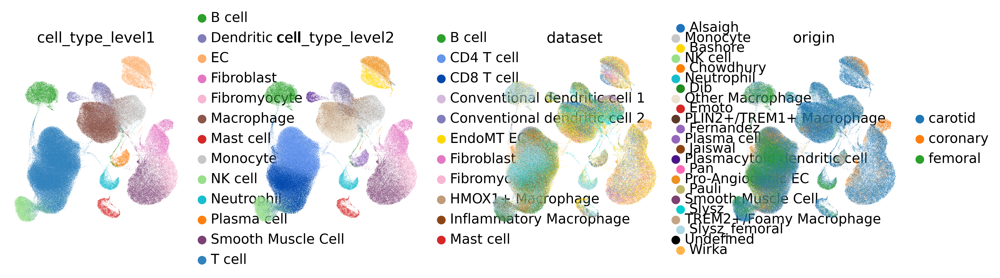

In [94]:
# Plot UMAP with custom color palette
sc.pl.umap(
    adata_all,
    color=['cell_type_level1','cell_type_level2', "dataset", "origin"],
    show=True,
    frameon=False,
)

In [95]:
adata_all.write("Big_Atlas_with_Bashore_CellxGeneformat_onlyuncorrectedcountslayer.h5ad")

In [ ]:
# remove duplicated from James

In [2]:
adata = sc.read_h5ad("Big_Atlas_with_Bashore_CellxGeneformat_onlyuncorrectedcountslayer.h5ad")

In [17]:
adata

AnnData object with n_obs × n_vars = 259757 × 26023
    obs: 'donor_id', 'dataset', 'cell_type_level1', 'cell_type_level2', 'origin', 'sorting', 'organism_ontology_term_id', 'disease_ontology_term_id', 'tissue_type', 'tissue_ontology_term_id', 'suspension_type', 'assay_ontology_term_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'cell_type_ontology_term_id', 'sample_id'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'
    uns: 'cell_type_level1_colors', 'cell_type_level2_colors', 'dataset_colors', 'origin_colors'
    obsm: 'X_scpoli', 'X_umap'
    layers: 'uncorrected_counts'

In [10]:
data = pd.read_csv("tmp/Korbinian_duplicates.csv", index_col=0)

In [12]:
filtered_data = data[data['dataset'].str.contains("Chowdhury", na=False)]

In [14]:
barcodes_to_remove = filtered_data.index

In [16]:
len(barcodes_to_remove)

35

In [18]:
# Remove the barcodes from the AnnData object
adata = adata[~adata.obs.index.isin(barcodes_to_remove)].copy()

In [19]:
adata

AnnData object with n_obs × n_vars = 259722 × 26023
    obs: 'donor_id', 'dataset', 'cell_type_level1', 'cell_type_level2', 'origin', 'sorting', 'organism_ontology_term_id', 'disease_ontology_term_id', 'tissue_type', 'tissue_ontology_term_id', 'suspension_type', 'assay_ontology_term_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'cell_type_ontology_term_id', 'sample_id'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'original_gene_names'
    uns: 'cell_type_level1_colors', 'cell_type_level2_colors', 'dataset_colors', 'origin_colors'
    obsm: 'X_scpoli', 'X_umap'
    layers: 'uncorrected_counts'

In [ ]:
adata.write("Big_Atlas_with_Bashore_CellxGeneformat_onlyuncorrectedcountslayer_nodups.h5ad")

In [ ]:
# Add new normalization layer with all cells normalized together

In [ ]:
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri
import rpy2.robjects as ro
import logging
import rpy2.rinterface_lib.callbacks
import logging

from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [ ]:
adata.layers["log_normalized_individually"] = adata.X.copy()
adata.X = adata.raw.X
# Copy the data
adata_pp = adata.copy()

# Normalize data
print("Normalize the data...")
sc.pp.normalize_total(adata_pp, target_sum=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, svd_solver="arpack")
sc.pp.neighbors(adata_pp, n_pcs=30)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.22)

# Setup rpy2 and suppress R warnings
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()

# Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T.toarray()

# Define the R script as a string
r_script = """
library(scran)
size_factors = calculateSumFactors(data_mat, clusters=input_groups, min.mean=0.1)
"""

# Execute the R script
ro.globalenv['data_mat'] = data_mat
ro.globalenv['input_groups'] = input_groups
ro.r(r_script)
size_factors = ro.globalenv['size_factors']

# Remove intermediate adata_pp
del adata_pp

# Normalize adata
adata.obs['size_factors'] = size_factors
adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [ ]:
# add revision 2 ECs from level2 annotations
mapping = pd.read_csv("revision2_normalEC_mapping.csv")
mapping_idx = mapping.set_index('barcode')['new_ct']
adata.obs['cell_type_level2'] = adata.obs['cell_type_level2'].astype(str)
adata.obs['cell_type_level2'].update(mapping_idx)
adata.obs['cell_type_level2'] = adata.obs['cell_type_level2'].astype('category')

In [ ]:
adata.write("cxg_lognormalized_newECs.h5ad")